In [1]:
import ccxt
import numpy as np
import pandas as pd
import datetime as dt
from dateutil import tz
import matplotlib.pyplot as plt

import json
import time
import os
import sys

In [2]:
src_path = 'src/'
sys.path.append(os.path.abspath(src_path))
from func_get import *
from func_signal import *
from func_backtest import *

In [3]:
start_ts = time.time()

In [4]:
interval_dict = {
    '1m': 1,
    '5m': 5,
    '15m': 15,
    '30m': 30,
    '1h': 60,
    '2h': 120,
    '4h': 240,
    '1d': 1440
}

In [5]:
with open('../../_keys/ftx/ftx_read_keys.json') as keys_file:
    keys_dict = json.load(keys_file)
    
exchange = ccxt.ftx({'apiKey': keys_dict['apiKey'],
                     'secret': keys_dict['secret'],
                     'enableRateLimit': True})

### Config

In [6]:
project_name = 'cryptoris_30m'

In [7]:
start_date = dt.datetime(2021, 1, 1)
start_hour = 0
end_date = dt.datetime.today() - dt.timedelta(days=1)
reinvest_profit_flag = True

In [8]:
config_params = {
    'safety_ohlcv_range': 1000,
    'action_timeframe': '30m',
    'base': {
        'symbol': ['ETH-PERP', 'SOL-PERP', 'LUNA-PERP'],
        'open': {
            '30m': {
                'ema': {
                    'check': [check_signal_price],
                    'look_back': 1,
                    'windows': 200,
                    'revert': False
                },
                'supertrend': {
                    'check': [check_signal_price],
                    'look_back': 1,
                    'atr_range': 10,
                    'multiplier': 3,
                    'revert': False
                },
                'wt': {
                    'check': [check_signal_band],
                    'trigger': 'inner',
                    'channel_range': 10,
                    'average_range': 21,
                    'overbought': 53,
                    'oversold': -53,
                    'revert': False
                }
            },
            '1h': {
                'ema': {
                    'check': [check_signal_price],
                    'look_back': 1,
                    'windows': 200,
                    'revert': False
                },
                'supertrend': {
                    'check': [check_signal_price],
                    'look_back': 1,
                    'atr_range': 10,
                    'multiplier': 3,
                    'revert': False
                },
                'wt': {
                    'check': [check_signal_band],
                    'trigger': 'inner',
                    'channel_range': 10,
                    'average_range': 21,
                    'overbought': 53,
                    'oversold': -53,
                    'revert': False
                }        
            }    
            
        },
        'close': {
            '30m': {
                'supertrend': {
                    'check': [check_signal_price],
                    'look_back': 0,
                    'atr_range': 10,
                    'multiplier': 3,
                    'revert': False
                },
                'wt': {
                    'check': [check_signal_band],
                    'trigger': 'inner',
                    'channel_range': 10,
                    'average_range': 21,
                    'overbought': 53,
                    'oversold': -53,
                    'revert': False
                }    
            }
        }
    },
    'lead': {
        'symbol': ['BTC-PERP'],
        'open': {
            '30m': {
                'wt': {
                    'check': [check_signal_band],
                    'trigger': 'inner',
                    'channel_range': 10,
                    'average_range': 21,
                    'overbought': 53,
                    'oversold': -53,
                    'revert': False
                }
            }
        },
        'close': {
        }
    },
    'tp': {
        'price_percent': 5,
        'signal': None,
    },
    'sl': {
        'price_percent': None,
        'signal': {
            'timeframe': '30m',
            'signal': {
                'supertrend': {
                    'look_back': 0,
                    'atr_range': 10,
                    'multiplier': 3,
                    'revert': False
                }
            }
        }
    },
    'action_percent': 0.1,
    'leverage': 5,
    'taker_fee': 0.07
}

### Get data

In [9]:
ohlcv_df_dict = get_data(exchange, start_date, end_date, start_hour, interval_dict, config_params)

base: timeframe 1/2 symbol 1/3 date 1/463
base: timeframe 1/2 symbol 1/3 date 2/463
base: timeframe 1/2 symbol 1/3 date 3/463
base: timeframe 1/2 symbol 1/3 date 4/463
base: timeframe 1/2 symbol 1/3 date 5/463
base: timeframe 1/2 symbol 1/3 date 6/463
base: timeframe 1/2 symbol 1/3 date 7/463
base: timeframe 1/2 symbol 1/3 date 8/463
base: timeframe 1/2 symbol 1/3 date 9/463
base: timeframe 1/2 symbol 1/3 date 10/463
base: timeframe 1/2 symbol 1/3 date 11/463
base: timeframe 1/2 symbol 1/3 date 12/463
base: timeframe 1/2 symbol 1/3 date 13/463
base: timeframe 1/2 symbol 1/3 date 14/463
base: timeframe 1/2 symbol 1/3 date 15/463
base: timeframe 1/2 symbol 1/3 date 16/463
base: timeframe 1/2 symbol 1/3 date 17/463
base: timeframe 1/2 symbol 1/3 date 18/463
base: timeframe 1/2 symbol 1/3 date 19/463
base: timeframe 1/2 symbol 1/3 date 20/463
base: timeframe 1/2 symbol 1/3 date 21/463
base: timeframe 1/2 symbol 1/3 date 22/463
base: timeframe 1/2 symbol 1/3 date 23/463
base: timeframe 1/2 

base: timeframe 1/2 symbol 1/3 date 190/463
base: timeframe 1/2 symbol 1/3 date 191/463
base: timeframe 1/2 symbol 1/3 date 192/463
base: timeframe 1/2 symbol 1/3 date 193/463
base: timeframe 1/2 symbol 1/3 date 194/463
base: timeframe 1/2 symbol 1/3 date 195/463
base: timeframe 1/2 symbol 1/3 date 196/463
base: timeframe 1/2 symbol 1/3 date 197/463
base: timeframe 1/2 symbol 1/3 date 198/463
base: timeframe 1/2 symbol 1/3 date 199/463
base: timeframe 1/2 symbol 1/3 date 200/463
base: timeframe 1/2 symbol 1/3 date 201/463
base: timeframe 1/2 symbol 1/3 date 202/463
base: timeframe 1/2 symbol 1/3 date 203/463
base: timeframe 1/2 symbol 1/3 date 204/463
base: timeframe 1/2 symbol 1/3 date 205/463
base: timeframe 1/2 symbol 1/3 date 206/463
base: timeframe 1/2 symbol 1/3 date 207/463
base: timeframe 1/2 symbol 1/3 date 208/463
base: timeframe 1/2 symbol 1/3 date 209/463
base: timeframe 1/2 symbol 1/3 date 210/463
base: timeframe 1/2 symbol 1/3 date 211/463
base: timeframe 1/2 symbol 1/3 d

base: timeframe 1/2 symbol 1/3 date 378/463
base: timeframe 1/2 symbol 1/3 date 379/463
base: timeframe 1/2 symbol 1/3 date 380/463
base: timeframe 1/2 symbol 1/3 date 381/463
base: timeframe 1/2 symbol 1/3 date 382/463
base: timeframe 1/2 symbol 1/3 date 383/463
base: timeframe 1/2 symbol 1/3 date 384/463
base: timeframe 1/2 symbol 1/3 date 385/463
base: timeframe 1/2 symbol 1/3 date 386/463
base: timeframe 1/2 symbol 1/3 date 387/463
base: timeframe 1/2 symbol 1/3 date 388/463
base: timeframe 1/2 symbol 1/3 date 389/463
base: timeframe 1/2 symbol 1/3 date 390/463
base: timeframe 1/2 symbol 1/3 date 391/463
base: timeframe 1/2 symbol 1/3 date 392/463
base: timeframe 1/2 symbol 1/3 date 393/463
base: timeframe 1/2 symbol 1/3 date 394/463
base: timeframe 1/2 symbol 1/3 date 395/463
base: timeframe 1/2 symbol 1/3 date 396/463
base: timeframe 1/2 symbol 1/3 date 397/463
base: timeframe 1/2 symbol 1/3 date 398/463
base: timeframe 1/2 symbol 1/3 date 399/463
base: timeframe 1/2 symbol 1/3 d

base: timeframe 1/2 symbol 2/3 date 104/463
base: timeframe 1/2 symbol 2/3 date 105/463
base: timeframe 1/2 symbol 2/3 date 106/463
base: timeframe 1/2 symbol 2/3 date 107/463
base: timeframe 1/2 symbol 2/3 date 108/463
base: timeframe 1/2 symbol 2/3 date 109/463
base: timeframe 1/2 symbol 2/3 date 110/463
base: timeframe 1/2 symbol 2/3 date 111/463
base: timeframe 1/2 symbol 2/3 date 112/463
base: timeframe 1/2 symbol 2/3 date 113/463
base: timeframe 1/2 symbol 2/3 date 114/463
base: timeframe 1/2 symbol 2/3 date 115/463
base: timeframe 1/2 symbol 2/3 date 116/463
base: timeframe 1/2 symbol 2/3 date 117/463
base: timeframe 1/2 symbol 2/3 date 118/463
base: timeframe 1/2 symbol 2/3 date 119/463
base: timeframe 1/2 symbol 2/3 date 120/463
base: timeframe 1/2 symbol 2/3 date 121/463
base: timeframe 1/2 symbol 2/3 date 122/463
base: timeframe 1/2 symbol 2/3 date 123/463
base: timeframe 1/2 symbol 2/3 date 124/463
base: timeframe 1/2 symbol 2/3 date 125/463
base: timeframe 1/2 symbol 2/3 d

base: timeframe 1/2 symbol 2/3 date 292/463
base: timeframe 1/2 symbol 2/3 date 293/463
base: timeframe 1/2 symbol 2/3 date 294/463
base: timeframe 1/2 symbol 2/3 date 295/463
base: timeframe 1/2 symbol 2/3 date 296/463
base: timeframe 1/2 symbol 2/3 date 297/463
base: timeframe 1/2 symbol 2/3 date 298/463
base: timeframe 1/2 symbol 2/3 date 299/463
base: timeframe 1/2 symbol 2/3 date 300/463
base: timeframe 1/2 symbol 2/3 date 301/463
base: timeframe 1/2 symbol 2/3 date 302/463
base: timeframe 1/2 symbol 2/3 date 303/463
base: timeframe 1/2 symbol 2/3 date 304/463
base: timeframe 1/2 symbol 2/3 date 305/463
base: timeframe 1/2 symbol 2/3 date 306/463
base: timeframe 1/2 symbol 2/3 date 307/463
base: timeframe 1/2 symbol 2/3 date 308/463
base: timeframe 1/2 symbol 2/3 date 309/463
base: timeframe 1/2 symbol 2/3 date 310/463
base: timeframe 1/2 symbol 2/3 date 311/463
base: timeframe 1/2 symbol 2/3 date 312/463
base: timeframe 1/2 symbol 2/3 date 313/463
base: timeframe 1/2 symbol 2/3 d

base: timeframe 1/2 symbol 3/3 date 17/463
base: timeframe 1/2 symbol 3/3 date 18/463
base: timeframe 1/2 symbol 3/3 date 19/463
base: timeframe 1/2 symbol 3/3 date 20/463
base: timeframe 1/2 symbol 3/3 date 21/463
base: timeframe 1/2 symbol 3/3 date 22/463
base: timeframe 1/2 symbol 3/3 date 23/463
base: timeframe 1/2 symbol 3/3 date 24/463
base: timeframe 1/2 symbol 3/3 date 25/463
base: timeframe 1/2 symbol 3/3 date 26/463
base: timeframe 1/2 symbol 3/3 date 27/463
base: timeframe 1/2 symbol 3/3 date 28/463
base: timeframe 1/2 symbol 3/3 date 29/463
base: timeframe 1/2 symbol 3/3 date 30/463
base: timeframe 1/2 symbol 3/3 date 31/463
base: timeframe 1/2 symbol 3/3 date 32/463
base: timeframe 1/2 symbol 3/3 date 33/463
base: timeframe 1/2 symbol 3/3 date 34/463
base: timeframe 1/2 symbol 3/3 date 35/463
base: timeframe 1/2 symbol 3/3 date 36/463
base: timeframe 1/2 symbol 3/3 date 37/463
base: timeframe 1/2 symbol 3/3 date 38/463
base: timeframe 1/2 symbol 3/3 date 39/463
base: timef

base: timeframe 1/2 symbol 3/3 date 206/463
base: timeframe 1/2 symbol 3/3 date 207/463
base: timeframe 1/2 symbol 3/3 date 208/463
base: timeframe 1/2 symbol 3/3 date 209/463
base: timeframe 1/2 symbol 3/3 date 210/463
base: timeframe 1/2 symbol 3/3 date 211/463
base: timeframe 1/2 symbol 3/3 date 212/463
base: timeframe 1/2 symbol 3/3 date 213/463
base: timeframe 1/2 symbol 3/3 date 214/463
base: timeframe 1/2 symbol 3/3 date 215/463
base: timeframe 1/2 symbol 3/3 date 216/463
base: timeframe 1/2 symbol 3/3 date 217/463
base: timeframe 1/2 symbol 3/3 date 218/463
base: timeframe 1/2 symbol 3/3 date 219/463
base: timeframe 1/2 symbol 3/3 date 220/463
base: timeframe 1/2 symbol 3/3 date 221/463
base: timeframe 1/2 symbol 3/3 date 222/463
base: timeframe 1/2 symbol 3/3 date 223/463
base: timeframe 1/2 symbol 3/3 date 224/463
base: timeframe 1/2 symbol 3/3 date 225/463
base: timeframe 1/2 symbol 3/3 date 226/463
base: timeframe 1/2 symbol 3/3 date 227/463
base: timeframe 1/2 symbol 3/3 d

base: timeframe 1/2 symbol 3/3 date 394/463
base: timeframe 1/2 symbol 3/3 date 395/463
base: timeframe 1/2 symbol 3/3 date 396/463
base: timeframe 1/2 symbol 3/3 date 397/463
base: timeframe 1/2 symbol 3/3 date 398/463
base: timeframe 1/2 symbol 3/3 date 399/463
base: timeframe 1/2 symbol 3/3 date 400/463
base: timeframe 1/2 symbol 3/3 date 401/463
base: timeframe 1/2 symbol 3/3 date 402/463
base: timeframe 1/2 symbol 3/3 date 403/463
base: timeframe 1/2 symbol 3/3 date 404/463
base: timeframe 1/2 symbol 3/3 date 405/463
base: timeframe 1/2 symbol 3/3 date 406/463
base: timeframe 1/2 symbol 3/3 date 407/463
base: timeframe 1/2 symbol 3/3 date 408/463
base: timeframe 1/2 symbol 3/3 date 409/463
base: timeframe 1/2 symbol 3/3 date 410/463
base: timeframe 1/2 symbol 3/3 date 411/463
base: timeframe 1/2 symbol 3/3 date 412/463
base: timeframe 1/2 symbol 3/3 date 413/463
base: timeframe 1/2 symbol 3/3 date 414/463
base: timeframe 1/2 symbol 3/3 date 415/463
base: timeframe 1/2 symbol 3/3 d

base: timeframe 2/2 symbol 1/3 date 120/463
base: timeframe 2/2 symbol 1/3 date 121/463
base: timeframe 2/2 symbol 1/3 date 122/463
base: timeframe 2/2 symbol 1/3 date 123/463
base: timeframe 2/2 symbol 1/3 date 124/463
base: timeframe 2/2 symbol 1/3 date 125/463
base: timeframe 2/2 symbol 1/3 date 126/463
base: timeframe 2/2 symbol 1/3 date 127/463
base: timeframe 2/2 symbol 1/3 date 128/463
base: timeframe 2/2 symbol 1/3 date 129/463
base: timeframe 2/2 symbol 1/3 date 130/463
base: timeframe 2/2 symbol 1/3 date 131/463
base: timeframe 2/2 symbol 1/3 date 132/463
base: timeframe 2/2 symbol 1/3 date 133/463
base: timeframe 2/2 symbol 1/3 date 134/463
base: timeframe 2/2 symbol 1/3 date 135/463
base: timeframe 2/2 symbol 1/3 date 136/463
base: timeframe 2/2 symbol 1/3 date 137/463
base: timeframe 2/2 symbol 1/3 date 138/463
base: timeframe 2/2 symbol 1/3 date 139/463
base: timeframe 2/2 symbol 1/3 date 140/463
base: timeframe 2/2 symbol 1/3 date 141/463
base: timeframe 2/2 symbol 1/3 d

base: timeframe 2/2 symbol 1/3 date 308/463
base: timeframe 2/2 symbol 1/3 date 309/463
base: timeframe 2/2 symbol 1/3 date 310/463
base: timeframe 2/2 symbol 1/3 date 311/463
base: timeframe 2/2 symbol 1/3 date 312/463
base: timeframe 2/2 symbol 1/3 date 313/463
base: timeframe 2/2 symbol 1/3 date 314/463
base: timeframe 2/2 symbol 1/3 date 315/463
base: timeframe 2/2 symbol 1/3 date 316/463
base: timeframe 2/2 symbol 1/3 date 317/463
base: timeframe 2/2 symbol 1/3 date 318/463
base: timeframe 2/2 symbol 1/3 date 319/463
base: timeframe 2/2 symbol 1/3 date 320/463
base: timeframe 2/2 symbol 1/3 date 321/463
base: timeframe 2/2 symbol 1/3 date 322/463
base: timeframe 2/2 symbol 1/3 date 323/463
base: timeframe 2/2 symbol 1/3 date 324/463
base: timeframe 2/2 symbol 1/3 date 325/463
base: timeframe 2/2 symbol 1/3 date 326/463
base: timeframe 2/2 symbol 1/3 date 327/463
base: timeframe 2/2 symbol 1/3 date 328/463
base: timeframe 2/2 symbol 1/3 date 329/463
base: timeframe 2/2 symbol 1/3 d

base: timeframe 2/2 symbol 2/3 date 33/463
base: timeframe 2/2 symbol 2/3 date 34/463
base: timeframe 2/2 symbol 2/3 date 35/463
base: timeframe 2/2 symbol 2/3 date 36/463
base: timeframe 2/2 symbol 2/3 date 37/463
base: timeframe 2/2 symbol 2/3 date 38/463
base: timeframe 2/2 symbol 2/3 date 39/463
base: timeframe 2/2 symbol 2/3 date 40/463
base: timeframe 2/2 symbol 2/3 date 41/463
base: timeframe 2/2 symbol 2/3 date 42/463
base: timeframe 2/2 symbol 2/3 date 43/463
base: timeframe 2/2 symbol 2/3 date 44/463
base: timeframe 2/2 symbol 2/3 date 45/463
base: timeframe 2/2 symbol 2/3 date 46/463
base: timeframe 2/2 symbol 2/3 date 47/463
base: timeframe 2/2 symbol 2/3 date 48/463
base: timeframe 2/2 symbol 2/3 date 49/463
base: timeframe 2/2 symbol 2/3 date 50/463
base: timeframe 2/2 symbol 2/3 date 51/463
base: timeframe 2/2 symbol 2/3 date 52/463
base: timeframe 2/2 symbol 2/3 date 53/463
base: timeframe 2/2 symbol 2/3 date 54/463
base: timeframe 2/2 symbol 2/3 date 55/463
base: timef

base: timeframe 2/2 symbol 2/3 date 221/463
base: timeframe 2/2 symbol 2/3 date 222/463
base: timeframe 2/2 symbol 2/3 date 223/463
base: timeframe 2/2 symbol 2/3 date 224/463
base: timeframe 2/2 symbol 2/3 date 225/463
base: timeframe 2/2 symbol 2/3 date 226/463
base: timeframe 2/2 symbol 2/3 date 227/463
base: timeframe 2/2 symbol 2/3 date 228/463
base: timeframe 2/2 symbol 2/3 date 229/463
base: timeframe 2/2 symbol 2/3 date 230/463
base: timeframe 2/2 symbol 2/3 date 231/463
base: timeframe 2/2 symbol 2/3 date 232/463
base: timeframe 2/2 symbol 2/3 date 233/463
base: timeframe 2/2 symbol 2/3 date 234/463
base: timeframe 2/2 symbol 2/3 date 235/463
base: timeframe 2/2 symbol 2/3 date 236/463
base: timeframe 2/2 symbol 2/3 date 237/463
base: timeframe 2/2 symbol 2/3 date 238/463
base: timeframe 2/2 symbol 2/3 date 239/463
base: timeframe 2/2 symbol 2/3 date 240/463
base: timeframe 2/2 symbol 2/3 date 241/463
base: timeframe 2/2 symbol 2/3 date 242/463
base: timeframe 2/2 symbol 2/3 d

base: timeframe 2/2 symbol 2/3 date 408/463
base: timeframe 2/2 symbol 2/3 date 409/463
base: timeframe 2/2 symbol 2/3 date 410/463
base: timeframe 2/2 symbol 2/3 date 411/463
base: timeframe 2/2 symbol 2/3 date 412/463
base: timeframe 2/2 symbol 2/3 date 413/463
base: timeframe 2/2 symbol 2/3 date 414/463
base: timeframe 2/2 symbol 2/3 date 415/463
base: timeframe 2/2 symbol 2/3 date 416/463
base: timeframe 2/2 symbol 2/3 date 417/463
base: timeframe 2/2 symbol 2/3 date 418/463
base: timeframe 2/2 symbol 2/3 date 419/463
base: timeframe 2/2 symbol 2/3 date 420/463
base: timeframe 2/2 symbol 2/3 date 421/463
base: timeframe 2/2 symbol 2/3 date 422/463
base: timeframe 2/2 symbol 2/3 date 423/463
base: timeframe 2/2 symbol 2/3 date 424/463
base: timeframe 2/2 symbol 2/3 date 425/463
base: timeframe 2/2 symbol 2/3 date 426/463
base: timeframe 2/2 symbol 2/3 date 427/463
base: timeframe 2/2 symbol 2/3 date 428/463
base: timeframe 2/2 symbol 2/3 date 429/463
base: timeframe 2/2 symbol 2/3 d

base: timeframe 2/2 symbol 3/3 date 134/463
base: timeframe 2/2 symbol 3/3 date 135/463
base: timeframe 2/2 symbol 3/3 date 136/463
base: timeframe 2/2 symbol 3/3 date 137/463
base: timeframe 2/2 symbol 3/3 date 138/463
base: timeframe 2/2 symbol 3/3 date 139/463
base: timeframe 2/2 symbol 3/3 date 140/463
base: timeframe 2/2 symbol 3/3 date 141/463
base: timeframe 2/2 symbol 3/3 date 142/463
base: timeframe 2/2 symbol 3/3 date 143/463
base: timeframe 2/2 symbol 3/3 date 144/463
base: timeframe 2/2 symbol 3/3 date 145/463
base: timeframe 2/2 symbol 3/3 date 146/463
base: timeframe 2/2 symbol 3/3 date 147/463
base: timeframe 2/2 symbol 3/3 date 148/463
base: timeframe 2/2 symbol 3/3 date 149/463
base: timeframe 2/2 symbol 3/3 date 150/463
base: timeframe 2/2 symbol 3/3 date 151/463
base: timeframe 2/2 symbol 3/3 date 152/463
base: timeframe 2/2 symbol 3/3 date 153/463
base: timeframe 2/2 symbol 3/3 date 154/463
base: timeframe 2/2 symbol 3/3 date 155/463
base: timeframe 2/2 symbol 3/3 d

base: timeframe 2/2 symbol 3/3 date 321/463
base: timeframe 2/2 symbol 3/3 date 322/463
base: timeframe 2/2 symbol 3/3 date 323/463
base: timeframe 2/2 symbol 3/3 date 324/463
base: timeframe 2/2 symbol 3/3 date 325/463
base: timeframe 2/2 symbol 3/3 date 326/463
base: timeframe 2/2 symbol 3/3 date 327/463
base: timeframe 2/2 symbol 3/3 date 328/463
base: timeframe 2/2 symbol 3/3 date 329/463
base: timeframe 2/2 symbol 3/3 date 330/463
base: timeframe 2/2 symbol 3/3 date 331/463
base: timeframe 2/2 symbol 3/3 date 332/463
base: timeframe 2/2 symbol 3/3 date 333/463
base: timeframe 2/2 symbol 3/3 date 334/463
base: timeframe 2/2 symbol 3/3 date 335/463
base: timeframe 2/2 symbol 3/3 date 336/463
base: timeframe 2/2 symbol 3/3 date 337/463
base: timeframe 2/2 symbol 3/3 date 338/463
base: timeframe 2/2 symbol 3/3 date 339/463
base: timeframe 2/2 symbol 3/3 date 340/463
base: timeframe 2/2 symbol 3/3 date 341/463
base: timeframe 2/2 symbol 3/3 date 342/463
base: timeframe 2/2 symbol 3/3 d

lead: timeframe 1/1 symbol 1/1 date 46/463
lead: timeframe 1/1 symbol 1/1 date 47/463
lead: timeframe 1/1 symbol 1/1 date 48/463
lead: timeframe 1/1 symbol 1/1 date 49/463
lead: timeframe 1/1 symbol 1/1 date 50/463
lead: timeframe 1/1 symbol 1/1 date 51/463
lead: timeframe 1/1 symbol 1/1 date 52/463
lead: timeframe 1/1 symbol 1/1 date 53/463
lead: timeframe 1/1 symbol 1/1 date 54/463
lead: timeframe 1/1 symbol 1/1 date 55/463
lead: timeframe 1/1 symbol 1/1 date 56/463
lead: timeframe 1/1 symbol 1/1 date 57/463
lead: timeframe 1/1 symbol 1/1 date 58/463
lead: timeframe 1/1 symbol 1/1 date 59/463
lead: timeframe 1/1 symbol 1/1 date 60/463
lead: timeframe 1/1 symbol 1/1 date 61/463
lead: timeframe 1/1 symbol 1/1 date 62/463
lead: timeframe 1/1 symbol 1/1 date 63/463
lead: timeframe 1/1 symbol 1/1 date 64/463
lead: timeframe 1/1 symbol 1/1 date 65/463
lead: timeframe 1/1 symbol 1/1 date 66/463
lead: timeframe 1/1 symbol 1/1 date 67/463
lead: timeframe 1/1 symbol 1/1 date 68/463
lead: timef

lead: timeframe 1/1 symbol 1/1 date 234/463
lead: timeframe 1/1 symbol 1/1 date 235/463
lead: timeframe 1/1 symbol 1/1 date 236/463
lead: timeframe 1/1 symbol 1/1 date 237/463
lead: timeframe 1/1 symbol 1/1 date 238/463
lead: timeframe 1/1 symbol 1/1 date 239/463
lead: timeframe 1/1 symbol 1/1 date 240/463
lead: timeframe 1/1 symbol 1/1 date 241/463
lead: timeframe 1/1 symbol 1/1 date 242/463
lead: timeframe 1/1 symbol 1/1 date 243/463
lead: timeframe 1/1 symbol 1/1 date 244/463
lead: timeframe 1/1 symbol 1/1 date 245/463
lead: timeframe 1/1 symbol 1/1 date 246/463
lead: timeframe 1/1 symbol 1/1 date 247/463
lead: timeframe 1/1 symbol 1/1 date 248/463
lead: timeframe 1/1 symbol 1/1 date 249/463
lead: timeframe 1/1 symbol 1/1 date 250/463
lead: timeframe 1/1 symbol 1/1 date 251/463
lead: timeframe 1/1 symbol 1/1 date 252/463
lead: timeframe 1/1 symbol 1/1 date 253/463
lead: timeframe 1/1 symbol 1/1 date 254/463
lead: timeframe 1/1 symbol 1/1 date 255/463
lead: timeframe 1/1 symbol 1/1 d

lead: timeframe 1/1 symbol 1/1 date 422/463
lead: timeframe 1/1 symbol 1/1 date 423/463
lead: timeframe 1/1 symbol 1/1 date 424/463
lead: timeframe 1/1 symbol 1/1 date 425/463
lead: timeframe 1/1 symbol 1/1 date 426/463
lead: timeframe 1/1 symbol 1/1 date 427/463
lead: timeframe 1/1 symbol 1/1 date 428/463
lead: timeframe 1/1 symbol 1/1 date 429/463
lead: timeframe 1/1 symbol 1/1 date 430/463
lead: timeframe 1/1 symbol 1/1 date 431/463
lead: timeframe 1/1 symbol 1/1 date 432/463
lead: timeframe 1/1 symbol 1/1 date 433/463
lead: timeframe 1/1 symbol 1/1 date 434/463
lead: timeframe 1/1 symbol 1/1 date 435/463
lead: timeframe 1/1 symbol 1/1 date 436/463
lead: timeframe 1/1 symbol 1/1 date 437/463
lead: timeframe 1/1 symbol 1/1 date 438/463
lead: timeframe 1/1 symbol 1/1 date 439/463
lead: timeframe 1/1 symbol 1/1 date 440/463
lead: timeframe 1/1 symbol 1/1 date 441/463
lead: timeframe 1/1 symbol 1/1 date 442/463
lead: timeframe 1/1 symbol 1/1 date 443/463
lead: timeframe 1/1 symbol 1/1 d

### Add signal

In [10]:
ohlcv_df_dict = add_signal(start_date, ohlcv_df_dict, interval_dict, config_params)

base add ema to ETH-PERP 1h
base add supertrend to ETH-PERP 1h
base add wt to ETH-PERP 1h
base add ema to SOL-PERP 1h
base add supertrend to SOL-PERP 1h
base add wt to SOL-PERP 1h
base add ema to LUNA-PERP 1h
base add supertrend to LUNA-PERP 1h
base add wt to LUNA-PERP 1h
base add ema to ETH-PERP 30m
base add supertrend to ETH-PERP 30m
base add wt to ETH-PERP 30m
base add ema to SOL-PERP 30m
base add supertrend to SOL-PERP 30m
base add wt to SOL-PERP 30m
base add ema to LUNA-PERP 30m
base add supertrend to LUNA-PERP 30m
base add wt to LUNA-PERP 30m
lead add wt to BTC-PERP 30m


### Back test

In [11]:
action_time_list = gen_action_time_list(config_params, ohlcv_df_dict)
max_open_timeframe = get_max_open_timeframe(config_params, interval_dict)

In [12]:
budget = 100

transaction_dict = {
    'symbol': [],
    'side': [],
    'amount': [],
    'open_time': [],
    'open_price': [],
    'close_time': [],
    'close_price': [],
    'notional': [],
    'profit': [],
    'profit_percent': []
}

position_dict = {}

if reinvest_profit_flag == True:
    budget_dict = {
        'time': [],
        'budget': []
    }
    
max_drawdown = 0

In [13]:
if reinvest_profit_flag == True:
    min_budget = budget

time_count = 0

for signal_time in action_time_list:
    action_time = signal_time + dt.timedelta(minutes=interval_dict[config_params['action_timeframe']])
    
    time_count += 1
    print(f"Time {action_time}: progress {time_count}/{len(action_time_list)}")

    '''
    Close positions
    '''
    for symbol in [x for x in position_dict.keys()]:
        print(f"  {symbol}")
        budget, max_drawdown, position_dict, transaction_dict = close_position(symbol, signal_time, max_drawdown, config_params, budget, reinvest_profit_flag, ohlcv_df_dict, position_dict, transaction_dict, interval_dict)

    '''
    Open positions
    '''
    max_position = int(1 / config_params['action_percent'])

    for symbol in [x for x in config_params['base']['symbol'] if x not in position_dict.keys()][:max_position]:
        print(f"  {symbol}")
        position_dict = open_position(symbol, signal_time, max_open_timeframe, config_params, budget, ohlcv_df_dict, position_dict, interval_dict)    
    
    '''
    Update budget
    '''
    if reinvest_profit_flag == True:
        budget_dict['time'].append(signal_time)
        budget_dict['budget'].append(budget)

        if budget < min_budget:
            min_budget = budget

    if budget <= 0:
        print(f"Out of money at {action_time}")
        break
        
'''
Clear final position
'''
opened_symbol = list(position_dict.keys())

for symbol in opened_symbol:
    print(f" Clear {symbol} position")
    
    side = position_dict[symbol]['side']
    ohlcv_df = ohlcv_df_dict['base'][config_params['action_timeframe']][symbol]
    current_ohlcv_df = ohlcv_df[ohlcv_df['time'] == signal_time].reset_index(drop=True)
    close_price = current_ohlcv_df.loc[0, 'close']
    
    budget, position_dict, transaction_dict = update_close_position(symbol, side, close_price, signal_time, config_params, budget, reinvest_profit_flag, position_dict, transaction_dict, interval_dict)

Time 2021-01-01 00:30:00: progress 1/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-01 01:00:00: progress 2/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_pri

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-01 20:30:00: progress 41/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-01 21:00:00: progress 42/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base 

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-02 14:00:00: progress 76/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_ban

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-03 09:00:00: progress 114/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_ba

     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-04 03:00:00: progress 150/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-04 23:30:00: progress 191/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-05 19:00:00: progress 230/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_si

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-06 12:00:00: progress 264/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SO

     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-07 05:00:00: progress 298/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_pri

     Closed by sl at 1213.6211457345803
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 0.045141082426311534
     price: 1235.25
     tp: 1297.0125
     sl: 1213.6211457345803
  LUNA-PERP
     Not available data
Time 2021-01-08 03:30:00: progress 343/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     Not available data
Time 2021-01-08 04:00:00: progress 344/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 3

     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-09 00:00:00: progress 384/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price 

     Not available data
Time 2021-01-09 20:00:00: progress 424/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-09 20:30:00: progress 425/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP c

     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-10 16:00:00: progress 464/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal

     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-11 10:30:00: progress 501/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_pr

     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-12 03:30:00: progress 535/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_p

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-12 21:00:00: progress 570/20208
  SOL-PERP
     Closed by sl at 3.2715534049904016
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 0.05178696934130461
     price: 1025.9
     tp: 974.605
     sl: 1136.1591785535952
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
  

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-13 20:30:00: progress 617/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-13 21:00:00: prog

     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-14 14:00:00: progress 652/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price s

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-15 07:30:00: progress 687/20208
  ETH-PERP
     Closed by tp at 1242.675
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_ban

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-16 01:30:00: progress 723/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_sig

     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 13.663312489316741
     price: 3.5075
     tp: 3.682875
     sl: 3.3845902719659406
  LUNA-PERP
     Not available data
Time 2021-01-16 19:00:00: progress 758/20208
  SOL-PERP
     Closed by sl at 3.3845902719659406
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-17 15:30:00: progress 799/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_sign

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     Not available data
Time 2021-01-18 08:00:00: progress 832/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     Not available data
Time 2021-01-18 08:30:00: progress 833/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     Closed by sl at 3.5953027515604714
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertren

     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-19 07:00:00: progress 878/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 1216.637319532058
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-19 07:30:00: progress 879/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-20 00:30:00: progress 913/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-20 18:30:00: progress 949/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base S

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-21 12:00:00: progress 984/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     Not a

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-22 05:30:00: progress 1019/20208
  ETH-PERP
     Closed by tp at 1157.765
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     Not availab

     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-22 23:00:00: progress 1054/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-23 17:30:00: progress 1091/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h:

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-24 16:00:00: progress 1136/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SO

     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-25 10:00:00: progress 1172/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-26 04:30:00: progress 1209/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: 

  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     Closed by signal at 1285.3
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-26 21:30:00: progress 1243/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP c

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-27 14:30:00: progress 1277/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-27 15:00:00: pro

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-28 09:30:00: progress 1315/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP che

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-29 00:00:00: progress 1344/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-29 00:30:00: progress 1

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 1284.669762708377
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-29 17:00:00: progress 1378/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 1290.0577864375396
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_sig

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-30 13:00:00: progress 1418/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-01-30 13:30:00: progress 1419/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: 

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-31 07:00:00: progress 1454/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-01-31 07:30:00: progress 1455/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PE

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-01 00:30:00: progress 1489/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-01 17:00:00: progress 1522/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-01 17:30:00: progre

     buy: 8.748381017592797
     price: 4.5125
     tp: 4.738125
     sl: 4.3639018204932585
  LUNA-PERP
     Not available data
Time 2021-02-02 09:00:00: progress 1554/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-02-02 09:30:00: progress 1555/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     Closed by signal at 4.6675
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     bas

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-03 02:30:00: progress 1589/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h:

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     Not available data
Time 2021-02-03 18:30:00: progress 1621/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     Not available data
Time 2021-02-03 19:00:00: progress 1622/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     Not available data
Time 2021-02-03 19:30:00: progress 1623/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal

     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-04 12:30:00: progress 1657/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signa

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-02-05 03:30:00: progress 1687/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_sig

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-05 20:30:00: progress 1721/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: 

     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-06 13:00:00: progress 1754/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_sig

     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 6.9025847893690075
     price: 6.295
     tp: 6.60975
     sl: 5.9317546441154665
  LUNA-PERP
     Not available data
Time 2021-02-07 05:00:00: progress 1786/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     No

     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 6.467660051468814
     price: 6.7325
     tp: 7.0691250000000005
     sl: 6.234063281996999
  LUNA-PERP
     Not available data
Time 2021-02-07 20:30:00: progress 1817/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 6.351031953797298
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-08 13:00:00: progress 1850/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 6.589415549965658
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-08 13:30:00: progress 1851/20208
  SOL-PERP
     Closed by tp at 7.310625000000001
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-09 05:00:00: progress 1882/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-09 05:30:00: progress 1883/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
   

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-09 21:30:00: progress 1915/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signa

     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-10 13:30:00: progress 1947/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     l

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-11 06:00:00: progress 1980/20208
  SOL-PERP
     Closed by tp at 8.919749999999999
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 4.926827767060028
     pric

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-11 23:30:00: progress 2015/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-12 00:00:00: p

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-12 16:00:00: progress 2048/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: 

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-02-13 07:30:00: progress 2079/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL

     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-13 23:00:00: progress 2110/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP che

     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-14 14:00:00: progress 2140/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_pri

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-15 06:00:00: progress 2172/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     Not available data
Time 2021-02-15 06:30:00: progress 2173/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 3

     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-02-15 21:30:00: progress 2203/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_sign

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-02-16 14:00:00: progress 2236/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-02-17 04:30:00: progress 2265/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-02-17 05:00:00: progress

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-02-17 21:00:00: progress 2298/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-02-17 21:30:00: progress 2299/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP


     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-02-18 14:00:00: progress 2332/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     Not available data
Time 2021-02-19 09:30:00: progress 2371/20208
  ETH-PERP
     Closed by sl at 1905.44647524785
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 0.02325120282868166
     price: 1909.5
     tp: 2004.9750000000001
     sl: 1905.44647524785
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
   

     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-02-19 23:15:00: progress 2398/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signa

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-02-20 11:00:00: progress 2422/20208
  LUNA-PERP
     base LUNA-PERP check_signal_pric

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 7.409948863728148
     price: 6.142
     tp: 5.8349
     sl: 6.632297352423416
Time 2021-02-20 23:00:00: progress 2446/20208
  ETH-PERP
     Closed by sl at 1980.7443485792548
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 6.613017609172901
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP c

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-02-21 11:00:00: progress 2470/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signa

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-02-21 22:30:00: progress 2493/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price 

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-02-22 09:30:00: progress 2515/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 6.2738527135213715
     price: 7.099
     tp: 7.453950000000001
     sl: 7.062508136205586
Time 2021-02-22 20:30:00: progress 2537/20208
  LUNA-PERP
     Closed by sl at 7.062508136205586
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_sign

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 3.404590475635638
     price: 14.335
     tp: 15.051750000000002
     sl: 12.186632714334198
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-02-23 07:30:00: progress 2559/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     Closed by signal

     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-02-23 18:30:00: progress 2581/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
    

     base SOL-PERP check_signal_band wt 30m: sell
     Closed by signal at 16.12
  ETH-PERP
     Closed by sl at 1616.1266636152784
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP ch

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: bu

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-02-25 08:00:00: progress 2656/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price super

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-02-25 18:30:00: progress 2677/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     ba

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 6.661956240633043
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 1621.6656524627672
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-02-26 05:30:00: progress 2699/20208
  LUNA-PERP
     Closed by tp at 6.17595
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     Closed by signal at 1537.8
  ETH-PERP
     base ETH-PERP check_signa

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-02-26 16:00:00: progress 2720/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price s

     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 0.03539933922246046
     price: 1447.8
     tp: 1375.4099999999999
     sl: 1548.405645025777
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-02-27 04:00:00: progress 2744/20208
  ETH-PE

  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-02-27 16:30:00: progress 2769/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     ba

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-02-28 05:00:00: progress 2794/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price s

     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-03-01 04:00:00: progress 2840/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 3.825221795865036
     price: 13.6825
     tp: 14.366624999999999
     sl: 12.510558632216268
  LUNA-PERP
     bas

     buy: 3.5932789948389003
     price: 14.505
     tp: 15.230250000000002
     sl: 13.736963357059484
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-03-01 15:00:00: progress 2862/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h

     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-03-02 02:00:00: progress 2884/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base 

     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-03-02 14:00:00: progress 2908/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-03-02 14:30:00: progress 2909/20208
  ETH-PERP
     base ETH-PERP 

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-03-03 04:00:00: progress 2936/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 1532.0204367589993
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m

     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-03-03 17:00:00: progress 2962/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-P

     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 0.03249905829580609
     price: 1579.0
     tp: 1657.95
     sl: 1575.9660881374175
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-03-04 04:30:00: progress 2985/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     Closed by sl at 1575.9660881374175
  ETH-PERP
     base ETH-P

     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-03-04 15:30:00: progress 3007/20208
  ETH-PERP
     base ETH-PERP check_sig

     Update sl: 1590.8608661830199
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-03-05 04:00:00: progress 3032/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not c

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-03-05 14:30:00: progress 3053/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
  

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-03-06 01:30:00: progress 3075/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal

     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 1507.2760804157547
Time 2021-03-06 13:30:00: progress 3099/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 1534.5484723741795
Time 2021-03-06 14:00:00: progress 3100/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_sign

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-03-07 01:30:00: progress 3123/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 1553.9507583601812
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: s

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-03-07 12:00:00: progress 3144/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price 

  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-03-07 22:30:00: progress 3165/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_b

     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-03-08 12:00:00: progress 3192/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_p

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-03-08 22:30:00: progress 3213/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 0.031616041893360654
     price: 1745.8
     tp: 1833.09
     sl: 1673.551609617228
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band 

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-03-09 09:00:00: progress 3234/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price 

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-03-09 20:00:00: progress 3256/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-03-09 20:30:00: progress 3257/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_pri

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-03-10 08:30:00: progress 3281/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price

     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     

     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-03-11 03:00:00: progress 3318/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     b

     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-03-11 13:00:00: progress 3338/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     b

     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-03-11 23:00:00: progress 3358/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal

  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     Closed by signal at 16.365
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 10.734079545436014
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-03-12 10:00:00: progress 3380/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band w

     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 4.862103115553971
     price: 12.361
     tp: 12.97905
     sl: 11.84142064389983
Time 2021-03-12 22:00:00: progress 3404/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PER

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-03-13 08:00:00: progress 3424/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-03-13 19:30:00: progress 3447/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema

     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-03-14 16:00:00: progress 3488/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_sign

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-03-15 02:30:00: progress 3509/20208
  LUNA-PERP
     base LUNA-PERP check_signal

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-03-15 13:00:00: progress 3530/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 14.786247567730825
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 

     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-03-16 00:30:00: progress 3553/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 1829.0078375519854
  LUNA-PERP
     base LUNA-PERP check_signal_price 

     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-03-16 13:00:00: progress 3578/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     Closed by tp at 13.24775
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertre

     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-03-17 00:00:00: progress 3600/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     bas

     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-03-17 10:00:00: progress 3620/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_

     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-03-17 21:00:00: progress 3642/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_s

     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-03-18 07:00:00: progress 3662/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-03-18 19:00:00: progress 3686/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     Closed by sl at 1803.5004988637097
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_

     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-03-19 07:00:00: progress 3710/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     Closed by sl at 14.216468488751225
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30

     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h:

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-03-20 03:00:00: progress 3750/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     Closed by signal at 1828.3
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BT

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-03-20 16:00:00: progress 3776/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_p

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-03-21 02:30:00: progress 3797/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
  

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-03-21 14:00:00: progress 3820/20208
  LUNA-PERP
     base LUNA-PERP check_signal

  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 2.79470476829871
     price: 21.777
     tp: 22.865850000000002
     sl: 21.198386171085676
Time 2021-03-22 01:00:00: progress 3842/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-03-22 13:30:00: progress 3867/20208
  ETH-PERP
     Closed by sl at 1797.0716464071354
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 0.033780815108887904
     price: 1795.3
     tp: 1705.5349999999999
     sl: 1797.0716464071354
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP ch

     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-03-22 23:00:00: progress 3886/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-03-23 08:30:00: progress 3905/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No 

     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 0.035995282333812405
     price: 1686.0
     tp: 1601.6999999999998
     sl: 1722.118748460679
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-03-23 18:00:00: progress 3924/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band

  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-03-24 08:00:00: progress 3952/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 1708.7391179

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h:

     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-03-25 05:30:00: progress 3995/20208
  SOL-PERP
     Closed by tp at 13.70375
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ET

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-03-25 16:00:00: progress 4016/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 13.925428956525817
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
 

  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-03-26 04:00:00: progress 4040/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell

     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-03-26 16:30:00: progress 4065/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     bas

  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-03-27 02:30:00: progress 4085/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH

     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     l

     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-03-27 22:30:00: progress 4125/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_pr

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-03-28 11:30:00: progress 4151/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-03-28 12:00:00: progress 4152/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price

     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No 

     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
Time 2021-03-29 10:00:00: progress 4196/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
Time 2021-03-29 10:30:00: progress 4197/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band 

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-03-29 20:30:00: progress 4217/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supe

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-03-30 08:00:00: progress 4240/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     Closed by signal at 19.54
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_

     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-03-30 19:00:00: progress 4262/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     Closed by signal at 1851.3
  ETH-PERP
     base ETH-P

     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-03-31 06:00:00: progress 4284/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check

     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-03-31 16:00:00: progress 4304/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_p

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-04-01 03:00:00: progress 4326/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-04-01 03:30:00: progress 4327/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price su

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-04-01 16:00:00: progress 4352/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     Closed by sl at 19.57535949423677
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_p

     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-04-02 02:30:00: progress 4373/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_sign

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-04-02 13:30:00: progress 4395/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 18.556669013079702
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy


     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-04-02 23:00:00: progress 4414/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base E

     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-04-03 08:30:00: progress 4433/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30

     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-04-03 18:00:00: progress 4452/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-04-04 04:00:00: progress 4472/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
  

     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-04-04 14:00:00: progress 4492/20208
  SOL-PERP
     Closed by tp at 24.512249999999998
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     bas

     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-04-04 23:00:00: progress 4510/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead 

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-04-05 08:30:00: progress 4529/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 18.321190017684096
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell


     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-04-05 18:30:00: progress 4549/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_p

     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-04-06 05:30:00: progress 4571/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 2067.9433497763425
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
    

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     Closed by sl at 2086.965295526057
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 0.030811769924198117
     price: 2090.0
     tp: 2194.5
     sl: 2086.965295526057
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signa

     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-04-07 02:30:00: progress 4613/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 22.832044374801747
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: 

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-04-07 13:30:00: progress 4635/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     Closed by tp at 26.208000000000002
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_ban

     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-04-07 23:30:00: progress 4655/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signa

Time 2021-04-08 11:00:00: progress 4678/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
Time 2021-04-08 11:30:00: progress 4679/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
Time 2021-04-08 12:00:00: progress 4680/20208
  SOL-PERP
     base SOL-PERP check_signal_price s

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-04-08 23:00:00: progress 4702/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_ban

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-04-09 09:00:00: progress 4722/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 0.03086412320658268
     price: 2082.4
     tp: 2186.52
     sl: 2054.85134139545
  SOL-PERP
     base SOL-P

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-04-09 19:30:00: progress 4743/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signa

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-04-10 07:30:00: progress 4767/20208
  SOL-PERP
     Closed by sl at 27.65953887304712
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_sign

     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-04-10 17:30:00: progress 4787/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 0.02964792415782533
     price: 2182.5
     tp: 2291.625
     sl: 2125.082498455102
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base

     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     

     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
 

     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-04-11 22:30:00: progress 4845/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
    

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 4.3354869953176225
     price: 15.04
     tp: 14.287999999999998
     sl: 15.408324789208029
Time 2021-04-12 08:00:00: progress 4864/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 15.352792310287224
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signa

     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: s

     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 4.570918277214116
     price: 14.869
     tp: 14.125549999999999
     sl: 14.932904718717731
Time 2021-04-13 04:30:00: progress 4905/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-04-13 13:30:00: progress 4923/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price em

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-04-13 22:30:00: progress 4941/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-04-14 07:00:00: progress 4958/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supert

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 2.5262415323982883
     price: 26.745
     tp: 25.40775
     sl: 27.635668011622496
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-04-14 16:00:00: progress 4976/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell

     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-04-15 01:30:00: progress 4995/20208
  ETH-PERP
     Closed by sl at 2320.2104531955283
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 0.028551860916784574
     price: 2353.2
     tp: 2470.86
     sl: 2320.2104531955283
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 

     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-04-15 11:30:00: progress 5015/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_sign

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-04-15 22:00:00: progress 5036/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 2404.6375270912963
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
 

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 4.166675566874494
     price: 16.858
     tp: 17.7009
     sl: 16.73186072596219
Time 2021-04-16 08:00:00: progress 5056/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base S

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-04-16 17:30:00: progress 5075/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
   

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-04-17 03:30:00: progress 5095/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-04-17 15:30:00: progress 5119/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     Closed by sl at 26.35331736230283
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price 

     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-04-18 11:00:00: progress 5158/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No 

     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-04-18 20:00:00: progress 5176/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SO

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-04-19 07:00:00: progress 5198/20208
  LUNA-PERP
     base LUNA-PERP check_signal

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-04-19 17:00:00: progress 5218/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signa

     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-04-20 02:30:00: progress 5237/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: s

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-04-20 13:00:00: progress 5258/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-04-20 13:30:00: progress 5259/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_sign

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-04-20 23:00:00: progress 5278/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
  

     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-04-21 07:30:00: progress 5295/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     bas

     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-04-21 17:30:00: progress 5315/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_

  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-04-22 04:30:00: progress 5337/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_b

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-04-22 15:30:00: progress 5359/20208
  ETH-PERP
     base ETH-PERP check_signa

     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-04-23 00:30:00: progress 5377/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     ba

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-04-23 10:00:00: progress 5396/20208
  ETH-PERP
     base ETH-PERP check_signal_price e

     sell: 0.03335754228360884
     price: 2277.2
     tp: 2163.3399999999997
     sl: 2363.3293150844825
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 5.673448001212492
     price: 13.389
     tp: 12.719549999999998
     sl: 13.969579456810223
Time 2021-

     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-04-24 06:00:00: progress 5436/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-04-24 14:30:00: progress 5453/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
    

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-04-24 23:00:00: progress 5470/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_sig

     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-04-25 09:00:00: progress 5490/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signa

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-04-25 21:00:00: progress 5514/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 2221.8857423805593
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 41.319727716773485
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-04-25 21:30:00: progress 5515/20208
 

     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-04-26 06:30:00: progress 5533/20208
  ETH-PERP
     Closed by sl at 2309.905603077818
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 44.122446144618856
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-04-26 16:30:00: progress 5553/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     ba

     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-04-27 04:30:00: progress 5577/20208
  SOL-PERP
     Closed by sl at 44.122446144618856
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal

     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-04-27 14:30:00: progress 5597/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_p

     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-04-28 00:00:00: progress 5616/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     

     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-04-28 08:30:00: progress 5633/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead

     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: 

     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-04-29 04:00:00: progress 5672/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-04-29 04:30:00: progress 5673/20208
  ETH-PERP
     

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-04-29 15:00:00: progress 5694/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 2657.9659199428097
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: b

     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-04-30 01:00:00: progress 5714/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP ch

     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-04-30 10:30:00: progress 5733/20208
  LUNA-PERP
     Closed by sl at 16.344565167722727
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     bas

     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-04-30 19:30:00: progress 5751/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_pric

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 16.510233327897716
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-05-01 05:30:00: progress 5771/20208
  LUNA-PERP


     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-05-01 14:30:00: progress 5789/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_p

     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-05-02 00:00:00: progress 5808/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 2830.112676096302
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: bu

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-05-02 08:00:00: progress 5824/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: 

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-05-02 17:30:00: progress 5843/20208

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 0.02407636691844463
     price: 2948.4
     tp: 3095.82
     sl: 2889.609003909036
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-05-03 02:00:00: progress 5860/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH

     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-05-03 11:30:00: progress 5879/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band 

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 4.063375236013605
     price: 18.244
     tp: 19.156200000000002
     sl: 18.179702159054504
Time 2021-05-03 21:00:00: progress 5898/20208
  SOL-PERP
     Closed by sl at 47.47328643716352
  LUNA-PERP
     Closed by sl at 18.179702159054504
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_pr

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-05-04 05:30:00: progress 5915/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action

     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-05-04 14:00:00: progress 5932/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
   

     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 4.46781156022655
     price: 16.55
     tp: 15.7225
     sl: 17.454504019695207
Time 2021-05-04 22:30:00: progress 5949/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 17.213253617725687
  ETH-PERP
     base ETH-PERP c

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 1.701113043489485
     price: 43.9875
     tp: 41.788124999999994
     sl: 45.20273659998034
Time 2021-05-05 08:30:00: progress 5969/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     Closed by sl at 45.20273659998034
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: 

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-05-05 18:00:00: progress 5988/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No 

     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
  

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-05-06 11:30:00: progress 6023/20208
  ETH-PERP
     base ETH-PERP check_si

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-05-06 22:30:00: progress 6045/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 3431.5579597191404
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-05-06 23:00:00: progress 6046/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-P

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-05-07 08:30:00: progress 6065/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signa

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-05-07 17:30:00: progress 6083/20208
  LUNA-PERP
     base LUNA-PERP check_signal_

     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 16.947141695303316
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
Time 2021-05-08 13:00:00: progress 6122/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
Time 2021-05-08 13:30:00: progress 6123/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 44.7275539516654
  LUNA-PERP
     base LUNA-PERP check_si

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-05-09 00:00:00: progress 6144/

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-05-09 08:00:00: progress 6160/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price

     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-05-09 17:00:00: progress 6178/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band w

     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h:

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-05-10 10:00:00: progress 6212/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No acti

     sell: 1.495507172696813
     price: 44.3325
     tp: 42.115875
     sl: 45.70878115234901
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-05-10 18:30:00: progress 6229/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 45.413153037114114
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PE

     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-05-11 04:30:00: progress 6249/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
   

     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-05-11 13:00:00: progress 6266/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal

     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-05-11 23:00:00: progress 6286/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-05-11 23:30:00: progress 6287/20208
  LUNA-PERP
     bas

     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 43.7711529780147
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-05-12 17:00:00: progress 6322/20208
  SOL-PERP
 

     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 1.486974210162524
     price: 45.005
     tp: 47.255250000000004
     sl: 44.21353768021322
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-05-13 10:30:00: progress 6357/20208
  SOL-PERP
     Closed by sl at 42.962

     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-05-13 19:30:00: progress 6375/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_sig

     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 0.016371086340377712
     price: 3778.4
     tp: 3589.48
     sl: 3966.5145928722045
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 1.4953828750993146
     price: 41.365
     tp: 39.29675
     sl: 42.35838126129429
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: s

     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-05-14 16:30:00: progress 6417/20208
  SOL-PERP
     Closed by sl at 42.35838126129429
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
    

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-05-15 00:30:00: progress 6433/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base E

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-05-15 11:00:00: progress 6454/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-05-15 11:30:00: progress 6455/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close

     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-05-15 20:00:00: progress 6472/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
 

     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-05-16 05:30:00: progress 6491/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 1.2923646588351647
     price: 43.4575
     tp: 45.63037500000001
     sl: 

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-05-16 16:30:00: progress 6513/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 44.66699657090779
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     Closed by signal at 16.482
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
 

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-05-17 01:30:00: progress 6531/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30

     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-05-17 10:30:00: progress 6549/20208
  LUNA-PERP
     Closed by tp at 15.282649999999999
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-P

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-05-17 20:00:00: progress 6568/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 16.032063364906783
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ET

     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-05-18 06:30:00: progress 6589/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-05-18 07:00:00: progress 6590/20208
  SOL-PERP
     base 

     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-05-18 16:30:00: progress 6609/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_sig

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-05-19 01:00:00: progress 6626/20208
  LUNA-PERP
     Closed by sl at 15.433786402322283
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 1.1210189699538917
     price: 54.0175
     tp: 56.718375
     

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-05-19 10:00:00: progress 6644/20208
  SOL-PERP
     Closed by sl at 52.02270342698958
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
    

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-05-19 18:00:00: progress 6660/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signa

  SOL-PERP
     Closed by tp at 41.70975
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 1.4978657216883875
     price: 41.7325
     tp: 39.645875
     sl: 47.08050012363189
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check

     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-05-20 10:30:00: progress 6693/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
   

     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-05-20 19:30:00: progress 6711/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signa

     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
   

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-05-21 12:30:00: progress 6745/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-05-21 21:00:00: progress 6762/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_sig

     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-05-22 05:00:00: progress 6778/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
   

     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-05-22 14:00:00: progress 6796/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_si

     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-05-22 23:30:00: progress 6815/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 38.474447477692166
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PER

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-05-23 08:30:00: progress 6833/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
   

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-05-23 16:30:00: progress 6849/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price su

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-05-24 00:30:00: progress 6865/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_pric

     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 2.991942230716616
     price: 25.14
     tp: 23.883
     sl: 26.284452206452926
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP ch

     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-05-24 16:30:00: progress 6897/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead B

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-05-25 00:30:00: progress 6913/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price 

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-05-25 08:30:00: progress 6929/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     b

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h:

     sell: 2.1706980540538043
     price: 29.33
     tp: 27.8635
     sl: 29.76820550473664
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-05-26 00:30:00: progress 6961/20208
  SOL-PERP
     Closed by sl at 29.76820550473664
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-P

     Update sl: 2564.332826891688
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-05-26 09:30:00: progress 6979/20208
  ETH-PERP
     Closed by tp at 2826.3900000000003
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-05-26 17:00:00: progress 6994/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supe

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-05-27 01:30:00: progress 7011/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     ba

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-05-27 09:30:00: progress 7027/

     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
   

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-05-28 02:30:00: progress 7061/20208
  ETH-PERP
     base ETH-PERP check_signa

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-05-28 10:30:00: progress 7077/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price sup

     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-05-28 18:30:00: progress 7093/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     l

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-05-29 03:30:00: progress 7111/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP chec

     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-05-29 13:00:00: progress 7130/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
 

     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 

     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 2.379603134480953
     price: 27.3425
     tp: 25.975375
     sl: 27.795359094385876
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 11.847104643944913
     price: 5.492
     tp: 5.2174
     sl: 5.691822085373004
Time 2021-05-30 07:00:00: progress 7166/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
  

     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-05-30 16:00:00: progress 7184/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-05-31 00:00:00: progress 7200/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     bas

     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 2.003102400517049
     price: 31.1375
     tp: 32.694375
     sl: 29.054273812214316
Time 2021-05-31 16:00:00: progress 7232/20208
  LUNA-PERP
     Closed by sl at 6.116628964732373
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 29.691471430992888
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
    

  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-06-01 02:00:00: progress 7252/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_

     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-06-01 12:00:00: progress 7272/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
   

     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No ac

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-06-02 04:30:00: progress 7305/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_si

  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-06-02 14:00:00: progress 7324/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP 

     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-06-03 06:00:00: progress 7356/20208
  ETH-PERP
     Closed by sl at 2685.5496965677858
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy

     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 2730.050400873797
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-06-03 15:00:00: progress 7374/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_s

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-06-04 00:30:00: progress 7393/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 6.887226365581331
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
   

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-06-04 08:30:00: progress 7409/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price

     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-06-04 16:30:00: progress 7425/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal

     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-06-05 02:30:00: progress 7445/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal

     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-06-05 11:00:00: progress 7462/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_pri

  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 6.811420860209443
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 2789.138763774802
Time 2021-06-05 19:30:00: progress 7479/20208
  SOL-PERP
     Closed by sl at 39.3978666222947
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 6.7682287741885
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 2766.839887397322
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     b

     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-06-06 06:00:00: progress 7500/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     Closed by signal at 2574.4
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-P

     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-06-06 14:00:00: progress 7516/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     bas

     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-06-06 21:30:00: progress 7531/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base S

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: s

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-06-07 14:00:00: progress 7564/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP

     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-06-08 00:30:00: progress 7585/20208
  ETH-PERP
     Closed by sl at 2753.9147287338706
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SO

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-06-08 08:30:00: progress 7601/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
   

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 0.026833095029871603
     price: 2551.3
     tp: 2423.735
     sl: 2626.50152006889
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-06-08 16:00:00: progress 7616/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-06-09 01:00:00: progress 7634/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-06-09 09:30:00: progress 7651/20208
  SOL-PERP
     base SOL-PERP check_sig

     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-06-09 18:30:00: progress 7669/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signa

     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-06-10 03:30:00: progress 7687/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_

     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-06-10 12:30:00: progress 7705/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_pr

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 11.570588890819133
     price: 6.415
     tp: 6.73575
     sl: 5.861891314606276
Time 2021-06-10 21:30:00: progress 7723/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy


     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-06-11 06:30:00: progress 7741/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_pric

  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-06-11 16:00:00: progress 7760/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base S

     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-06-12 02:00:00: progress 7780/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_s

     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
   

     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-06-12 17:30:00: progress 7811/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base L

  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-06-13 02:30:00: progress 7829/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP ch

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-06-13 10:30:00: progress 7845/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sig

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-06-13 19:30:00: progress 7863/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_si

     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-06-14 11:00:00: progress 7894/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 5.953722259887357
Time 2021-06-14 22:00:00: progress 7916/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 2493.4558249251327
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     Closed by signal at 6.244
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_p

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-06-15 09:30:00: progress 7939/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 38.23211854056427
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-06-15 10:00:00: progress 7940/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_

     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-06-15 17:30:00: progress 7955/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_pr

     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-06-16 02:30:00: progress 7973/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_pr

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-06-16 10:30:00: progress 7989/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     ba

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-06-16 18:00:00: progress 8004/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 2544.556745204304
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: b

     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-06-17 01:30:00: progress 8019/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
  

     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-06-17 09:30:00: progress 8035/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 38.25664295742005
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m:

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-06-17 17:30:00: progress 8051/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     ba

     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-06-18 01:30:00: progress 8067/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 40.40718849459771
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 6.34608920742482
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No acti

  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
Time 2021-06-18 13:30:00: progress 8091/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
Time 2021-06-18 14:00:00: progress 8092/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 40.03705158935622
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-06-18 23:30:00: progress 8111/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_pri

     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-06-19 16:00:00: progress 8144/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP chec

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-06-20 02:30:00: progress 8165/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP chec

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-06-20 12:00:00: progress 8184/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP che

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-06-20 22:00:00: progress 8204/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_pri

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-06-21 12:30:00: progress 8233/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sig

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-06-21 20:00:00: progress 8248/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price s

     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-06-22 05:30:00: progress 8267/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     Closed by signal at 1896.6
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ET

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-06-22 13:30:00: progress 8283/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP 

     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-06-23 05:00:00: progress 8314/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price 

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-06-23 13:00:00: progress 8330/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price 

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-06-23 21:30:00: progress 8347/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price 

     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
   

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-06-24 12:30:00: progress 8377/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     ba

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-06-24 20:00:00: progress 8392/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     bas

     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-06-25 03:00:00: progress 8406/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BT

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-06-25 10:30:00: progress 8421/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 3.0128782899464843
     price: 29.815
     tp: 28.32425
     sl: 32.628206606212856
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-06-26 02:00:00: progress 8452/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     N

     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
Time 2021-06-26 12:30:00: progress 8473/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     Closed by sl at 5.286169317447101
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 16.926502254525595
     price: 5

     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
Time 2021-06-26 23:30:00: progress 8495/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
Time 2021-06-27 00:00:00: progress 8496/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-P

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-06-27 10:00:00: progress 8516/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price sup

     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-06-27 17:30:00: progress 8531/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     ba

     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     N

Time 2021-06-28 09:00:00: progress 8562/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
Time 2021-06-28 09:30:00: progress 8563/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
Time 2021-06-28 10:00:00: progress 8564/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertren

     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-06-28 19:00:00: progress 8582/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-06-28 19:30:00: progress 8583/20208
  SOL-PERP
     base SO

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 32.165249522336545
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 5.329481756554787
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-06-29 05:00:00: progress 8602/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 32.21922457010288
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: bu

     base SOL-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 32.58269050614458
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
Time 2021-06-29 16:30:00: progress 8625/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
Time 2021-06-29 17:00:00: progress 8626/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
     U

     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-06-30 00:00:00: progress 8640/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-06-30 07:30:00: progress 8655/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     Closed by sl at 2163.4621675900894
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 0.04579677097886255
     price: 2177.2
     tp: 2286.06
     sl: 2163.4621675900894
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base 

     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
 

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-06-30 22:30:00: progress 8685/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
    

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
Time 2021-07-01 06:30:00: progress 8701/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 33.72850138434255
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
Time 2021-07-01 07:00:00: progress 8702/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 2182.4420543680712
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 33.844401245908294
  LUNA-PERP


     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-07-01 16:30:00: progress 8721/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
    

     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: bu

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-07-02 07:00:00: progress 8750/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
  

     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-07-02 15:00:00: progress 8766/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signa

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-07-03 01:30:00: progress 8787/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal

     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-07-03 10:00:00: progress 8804/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_pric

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-07-03 18:00:00: progress 8820/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supe

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-07-04 02:00:00: progress 8836/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-07-04 02:30:00: progress 8837/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  

     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-07-04 11:30:00: progress 8855/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_p

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-07-04 21:00:00: progress 8874/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 0.04298226448972073
     price: 2327.7
     tp: 2444.085
     sl: 2326.060964175029
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 16.616810671437126
     price

     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-07-05 14:00:00: progress 8908/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signa

     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-07-05 21:30:00: progress 8923/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 34.41098937404543
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: s

     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-07-06 07:00:00: progress 8942/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_si

     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-07-06 15:00:00: progress 8958/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 33.320867545937446
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
 

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-07-06 22:30:00: progress 8973/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base

     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     le

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 33.78131219219041
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-07-07 13:30:00: progress 9003/20208
  SOL-PER

     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-07-07 21:00:00: progress 9018/20208
  LUNA-PERP
     Closed by tp at 7.189350000000001
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH

  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-07-08 05:00:00: progress 9034/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP chec

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-07-08 12:00:00: progress 9048/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price 

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-07-08 19:00:00: progress 9062/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No

     base ETH-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 2211.4862813040577
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-07-09 02:30:00: progress 9077/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30

     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-07-09 09:30:00: progress 9091/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
    

     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-07-09 18:30:00: progress 9109/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
  

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-07-10 02:30:00: progress 9125/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-07-10 09:30:00: progress 9139/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No a

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-07-10 17:30:00: progress 9155/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No 

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-07-11 01:00:00: progress 9170/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     

     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 12.82587577634305
     price: 8.372
     tp: 8.7906
     sl: 7.609449479559256
Time 2021-07-11 08:00:00: progress 9184/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 7.79040453160333
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_

     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-07-11 17:30:00: progress 9203/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 7.921014442186832
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m:

     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-07-12 03:00:00: progress 9222/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_s

     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-07-12 12:00:00: progress 9240/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_pri

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-07-12 19:30:00: progress 9255/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No a

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-07-13 02:30:00: progress 9269/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     

     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-07-13 10:00:00: progress 9284/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_b

     sell: 0.051380994213012024
     price: 2019.6
     tp: 1918.62
     sl: 2030.508029657432
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-07-13 18:30:00: progress 9301/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 31.027189554690892
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal

     Update sl: 30.17572645943016
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-07-14 03:30:00: progress 9319/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not 

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-07-14 11:00:00: progress 9334/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_pri

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-07-14 18:00:00: progress 9348/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-07-15 01:00:00: progress 9362/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action


     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-07-15 08:00:00: progress 9376/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price 

     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-07-15 15:00:00: progress 9390/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     b

     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 6.933382256827518
Time 2021-07-16 06:00:00: progress 9420/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
Time 2021-07-16 06:30:00: progress 9421/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell

     base ETH-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 1928.7370080822961
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 6.791735379015245
Time 2021-07-16 17:00:00: progress 9442/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 28.763666487161682
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 1928.2883072740667
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 6.753861841113721
Time 2021-07-16 17:30:00: progress 9443/20208
  SOL-PERP
     Closed by tp at 27.44075
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH

     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-07-17 02:00:00: progress 9460/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_sig

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-07-17 09:30:00: progress 9475/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 0.062173841205965696
     price: 1860.2
     tp: 1767.19
     sl: 1921.1015769980504
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base 

  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
Time 2021-07-17 20:30:00: progress 9497/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
Time 2021-07-17 21:00:00: progress 9498/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP 

     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-07-18 06:30:00: progress 9517/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signa

     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-07-18 13:30:00: progress 9531/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     

     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-07-18 20:30:00: progress 9545/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     bas

     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 1935.6706032635805
Time 2021-07-19 05:00:00: progress 9562/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 6.821545726496803
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
Time 2021-07-19 05:30:00: progress 9563/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 6.815641153847123


     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 4.305250600936603
     price: 26.0
     tp: 24.7
     sl: 26.833108069064785
Time 2021-07-19 14:00:00: progress 9580/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 26.75462043533186
Time 2021-07-19 14:30:00: progress 9581/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supert

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-07-19 22:00:00: progress 9596/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     b

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-07-20 05:00:00: progress 9610/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     N

     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell

     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 20.49705652176304
     price: 5.847
     tp: 5.5546500000000005
     sl: 5.851291950528668
Time 2021-07-20 19:30:00: progress 9639/20208
  LUNA-PERP
     Closed by sl at 5.851291950528668
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-07-21 02:30:00: progress 9653/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-07-21 09:30:00: progress 9667/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price 

     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-07-21 16:30:00: progress 9681/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base 

     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-07-21 23:30:00: progress 9695/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     b

     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     l

     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-07-22 14:00:00: progress 9724/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-07-22 1

     base SOL-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 26.637399532797343
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-07-23 00:00:00: progress 9744/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PE

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
Time 2021-07-23 08:30:00: progress 9761/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 1977.7402621811893
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
Time 2021-07-23 09:00:00: progress 9762/20208
  ETH-PERP
     Closed by tp at 2069.55
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 27.18273353948088
  LUNA

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 17.206980728887828
     price: 7.156
     tp: 7.5138
     sl: 7.155686298251709
Time 2021-07-23 17:30:00: progress 9779/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     Closed by sl at 7.155686298251709
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base 

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-07-24 01:30:00: progress 9795/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 27.676118139105377
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: b

     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
Time 2021-07-24 11:00:00: progress 9814/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 2073.7615467069336
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 7.468040681227902
Time 2021-07-24 11:30:00: progress 9815/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_ban

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-07-24 22:00:00: progress 9836/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP chec

     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-07-25 06:00:00: progress 9852/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-07-25 06:30:00: progress 9853/20208
  LUNA-PERP
     base LUNA-PER

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-07-25 15:30:00: progress 9871/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_

     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-07-25 23:30:00: progress 9887/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base

     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-07-26 06:30:00: progress 9901/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 0.05906243172794734
     price: 2185.9
     tp: 2295.195
     sl: 2127.2367602157788
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-07-26 13:30:00: progress 9915/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No act

     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 14.594314388512801
     price: 8.885
     tp: 9.32925
     sl: 8.814143805727076
Time 2021-07-26 21:30:00: progress 9931/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
Time 2021-07-26 22:00:00: progress 9932/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_sig

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-07-27 06:30:00: progress 9949/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No 

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-07-27 14:00:00: progress 9964/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-07-27 22:00:00: progress 9980/20208
  ETH-PERP
     base ETH-PERP check_signal_price 

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-07-28 05:30:00: progress 9995/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_sign

     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-07-28 13:00:00: progress 10010/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signa

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 14.03041472688163
     price: 9.237
     tp: 9.69885
     sl: 9.156590683510293
Time 2021-07-28 22:00:00: progress 10028/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base

     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-07-29 06:00:00: progress 10044/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_sign

     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-07-29 15:00:00: progress 10062/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_sign

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-07-29 23:30:00: progress 10079/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 2272.791896723316
  LUNA-PERP
     Closed by sl at 10.871902684220748
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_

     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-07-30 07:00:00: progress 10094/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 2320.2763075540497
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: se

     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-07-30 14:00:00: progress 10108/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base 

     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-07-30 20:30:00: progress 10121/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     ba

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-07-31 03:30:00: progress 10135/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     b

     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     ba

     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     Closed by signal at 34.67
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-07-31 19:30:00: progress 10167/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PE

     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 33.156162028379256
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-08-01 04:00:00: progress 10184/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 2429.134114163804
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 33.55117

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-08-01 11:00:00: progress 10198/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     bas

  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
Time 2021-08-01 19:30:00: progress 10215/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
Time 2021-08-01 20:00:00: progress 10216/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     Closed by signal at 11.397
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-P

     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-02 03:30:00: progress 10231/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 2576.0129991056015
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: se

     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-08-02 10:30:00: progress 10245/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_p

     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-08-02 17:30:00: progress 10259/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
   

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-08-03 00:00:00: progress 10272/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     ba

     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-03 07:00:00: progress 10286/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     b

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-08-03 13:30:00: progress 10299/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price

     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     N

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-04 03:30:00: progress 10327/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_sig

     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-04 11:30:00: progress 10343/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_sign

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-08-04 18:00:00: progress 10356/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_sig

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-08-05 02:00:00: progress 10372/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 34.79111405907197
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-08-05 02:30:00: progress 10373/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signa

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-08-05 10:00:00: progress 10388/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP che

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-08-05 18:30:00: progress 10405/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_

     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-06 01:30:00: progress 10419/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 2659.710742242372
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-06 02:00:00: progress 10420/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check

     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-06 10:30:00: progress 10437/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     Closed by sl at 36.2046256342607
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No ac

     base SOL-PERP check_signal_band wt 30m: buy
     Not close
Time 2021-08-06 19:30:00: progress 10455/20208
  ETH-PERP
     Closed by sl at 2725.8678735175827
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 0.050444778764170035
     price: 2788.2
     tp: 2927.61
     sl: 2725.8678735175827
Time 2021-08-06 20:00:00: progress 10456/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price sup

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-07 04:00:00: progress 10472/20208
  ETH-PERP
     base ETH-PERP check_signal_price em

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-07 12:00:00: progress 10488/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_pr

     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-07 20:00:00: progress 10504/20208
  SOL-PERP
     Closed by sl at 39.05084689287153
  LUNA-PERP
     Closed by sl at 14.952071916659424
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SO

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-08 02:30:00: progress 10517/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     b

     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
 

     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-08 16:30:00: progress 10545/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_s

     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-08-09 00:00:00: progress 10560/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
    

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-09 06:30:00: progress 10573/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
   

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-09 14:00:00: progress 10588/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_sig

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-09 22:00:00: progress 10604/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-09 22:30:00: progress 10605/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     Closed

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 10.048448068066948
     price: 14.072
     tp: 14.775599999999999
     sl: 13.707465961268259
Time 2021-08-10 06:30:00: progress 10621/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-P

     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-08-10 15:00:00: progress 10638/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 14.027586423632416
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h:

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 3.654615178103528
     price: 40.4275
     tp: 42.448875
     sl: 39.676940012686316
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-10 22:30:00: progress 10653/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_si

     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-11 12:30:00: progress 10681/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     Closed by signal at 42.33
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-P

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 8.4751854943725
     price: 17.205
     tp: 18.06525
     sl: 16.49885277872181
Time 2021-08-11 19:00:00: progress 10694/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     bas

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
Time 2021-08-12 02:30:00: progress 10709/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
Time 2021-08-12 03:00:00: progress 10710/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 16.742360947240005
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base

     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-12 16:30:00: progress 10737/20208
  ETH-PERP
     base ETH-PERP check_signal_pri

     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-08-12 23:00:00: progress 10750/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     b

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-13 05:30:00: progress 10763/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_p

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-13 13:00:00: progress 10778/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 16.51856960945658
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-13 13:30:00: progress 10779/20208
  LUNA-PERP
     base LUNA-PERP check_si

     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-13 20:00:00: progress 10792/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base S

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 8.686203532230707
     price: 17.745
     tp: 18.632250000000003
     sl: 16.883733973364333
Time 2021-08-14 04:00:00: progress 10808/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 3186.861021994113
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 17.017360576027897
Time 2021-08-14 04:30:00: progress 10809/20208
  ETH-PERP
     

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 43.22315903395851
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 3246.824247438945
Time 2021-08-14 14:00:00: progress 10828/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 3246.9318226950504
Time 2021-08-14 14:30:00: progress 10829/20208
  SOL-PERP

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-14 21:30:00: progress 10843/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     b

     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-15 04:00:00: progress 10856/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m

     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-15 11:00:00: progress 10870/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
    

     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-15 18:00:00: progress 10884/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     

     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-16 00:30:00: progress 10897/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     ba

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-16 07:30:00: progress 10911/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     Closed by signal at 3315.6
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP c

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-16 14:30:00: progress 10925/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-16 22:00:00: progress 10940/20208
  LUNA-PERP
     Closed by tp at 22.45635
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy


     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-08-17 05:00:00: progress 10954/20208
  SOL-PERP
     Closed by tp at 66.38625
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP chec

     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 7.180610325459163
     price: 25.045
     tp: 26.297250000000002
     sl: 21.981893680460757
Time 2021-08-17 11:30:00: progress 10967/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-17 19:30:00: progress 10983/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal

     Update sl: 3205.085991245069
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-08-18 04:00:00: progress 11000/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     Closed by

     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-18 10:30:00: progress 11013/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-18 1

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 6.713297205067215
     price: 26.149
     tp: 27.456450000000004
     sl: 24.11899308870832
Time 2021-08-18 19:30:00: progress 11031/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PE

     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-08-19 02:30:00: progress 11045/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal

     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-19 10:30:00: progress 11061/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 3079.959810913665
  SOL-PERP
     Closed by sl at 70.94373610890341
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     

     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-08-19 18:30:00: progress 11077/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 3059.5587255498262
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-08-19 19:00:00: progress 110

     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-08-20 01:30:00: progress 11091/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-P

     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-20 08:00:00: progress 11104/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base S

     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-08-20 14:30:00: progress 11117/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 3170.2997432786465
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sel

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-08-20 22:00:00: progress 11132/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     Closed by signal at 3286.0
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP ch

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-08-21 04:30:00: progress 11145/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_

     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 3222.7621656821216
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-21 13:30:00: progress 11163/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: b

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-21 21:30:00: progress 11179/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     Closed by sl at 75.63564705601608
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_

     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-08-22 04:00:00: progress 11192/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SO

     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
  

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-22 16:30:00: progress 11217/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-22 22:30:00: progress 11229/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 3239.4752049053927
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-23 05:00:00: progress 11242/20208
  ETH-PERP
     base ETH-PERP check_signal_pric

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 27.712281494932235
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-23 12:00:00: progress 11256/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 3275.0382881781934
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     Closed by signal at 29.546
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP 

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-23 20:00:00: progress 11272/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-23 20:30:00: progress 11273/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not clos

     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-24 04:30:00: progress 11289/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 27.853461516192095
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_

     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-24 11:30:00: progress 11303/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-

     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-24 18:30:00: progress 11317/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_p

     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-08-25 01:00:00: progress 11330/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead

     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-25 08:00:00: progress 11344/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-25 15:30:00: progress 11359/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 3249.264945997093
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price em

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-25 23:30:00: progress 11375/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     

     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-26 06:30:00: progress 11389/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_si

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-26 13:30:00: progress 11403/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 72.33330862126834
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band w

     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 1.9815577622609206
     price: 76.19
     tp: 79.9995
     sl: 69.2529860355041
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-08-26 22:00:00: progress 11420/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     N

     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 5.735577242355319
     price: 26.646
     tp: 25.3137
     sl: 27.988214313592994
Time 2021-08-27 08:00:00: progress 11440/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     Closed by tp at 79.9995
  LUNA-PERP
     Closed by sl at 27.988214313592994
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price s

     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-27 16:30:00: progress 11457/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_sig

     base SOL-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 78.40213588665736
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-28 00:00:00: progress 11472/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: b

     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-28 06:30:00: progress 11485/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     Closed by sl at 30.938439431295603
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-08-28 13:30:00: progress 11499/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 31.996430142089295
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-28 21:30:00: progress 11515/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-

     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-29 05:30:00: progress 11531/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 32.4332297981812
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_si

  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-08-29 13:00:00: progress 11546/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-

     base ETH-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 3245.6005436766213
  LUNA-PERP
     Closed by sl at 34.154141069731665
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 4.865314589752054
     price: 34.25
     tp: 35.9625
     sl: 34.154

     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-08-30 05:00:00: progress 11578/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base 

     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-08-30 11:30:00: progress 11591/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal

     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-30 19:30:00: progress 11607/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_si

     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-31 03:30:00: progress 11623/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 33.51022209841454
  ETH-PERP
   

     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-08-31 17:00:00: progress 11650/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-08-31 23:30:00: progress 11663/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_sig

     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-09-01 07:00:00: progress 11678/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 3332.478495992817
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m:

     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-09-01 14:30:00: progress 11693/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signa

     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
    

     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-09-02 03:30:00: progress 11719/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-09-02 10:00:00: progress 11732/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     b

     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     le

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-09-02 23:00:00: progress 11758/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     Closed by tp at 123.21225
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 1.4198048994110315
     price: 121.9875
     tp: 128.086875
     sl: 113.64787949279665
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PE

     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 5.232752501944243
     price: 33.388
     tp: 35.0574
     sl: 31.83507390053799
Time 2021-09-03 06:00:00: progress 11772/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     Closed by signal at 33.617
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 

     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-09-03 12:30:00: progress 11785/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     ba

     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
    

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-09-04 01:00:00: progress 11810/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 5.488806186362699
     price: 31.691
     tp: 30.10645
     sl: 32.58778240117405
Time 2021-09-04 08:30:00: progress 11825/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_s

     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
Time 2021-09-04 17:30:00: progress 11843/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
Time 2021-09-04 18:00:00: progress 11844/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP ch

     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 5.368576282884161
     price: 31.216
     tp: 29.6552
     sl: 32.42304102553997
Time 2021-09-05 01:00:00: progress 11858/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: s

     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-09-05 08:30:00: progress 11873/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_ba

     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-09-05 15:30:00: progress 11887/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_pri

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-09-05 23:00:00: progress 11902/20208
  ETH-PERP
     base ETH-PERP check_signal_

     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-09-06 06:00:00: progress 11916/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signa

     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-09-06 13:30:00: progress 11931/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_sign

     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-09-06 20:30:00: progress 11945/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_sig

     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-09-07 04:00:00: progress 11960/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-09-07 04:3

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-09-07 12:00:00: progress 11976/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_ban

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-09-07 19:00:00: progress 11990/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price 

     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-09-08 07:30:00: progress 12015/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     b

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-09-08 15:00:00: progress 12030/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 3509.221840858358
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema

     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-09-08 23:00:00: progress 12046/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_si

     Update sl: 172.37327451035878
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-09-09 06:00:00: progress 12060/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not c

     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-09-09 12:30:00: progress 12073/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead 

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-09-09 19:30:00: progress 12087/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signa

     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     l

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-09-10 09:00:00: progress 12114/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No ac

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-09-10 15:30:00: progress 12127/20208
  LUNA-PERP
     Closed by tp at 33.3669
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 3499.1303661588854
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
  

     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-09-10 22:00:00: progress 12140/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     bas

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-09-11 04:30:00: progress 12153/20208
  ETH-PERP
     base ETH-PERP check_signal_price e

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-09-11 10:30:00: progress 12165/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_sign

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-09-11 18:30:00: progress 12181/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_si

     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-09-12 02:00:00: progress 12196/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_b

     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-09-12 09:00:00: progress 12210/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal

     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-09-12 16:00:00: progress 12224/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_ban

     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-09-12 23:00:00: progress 12238/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     ba

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-09-13 05:30:00: progress 12251/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_sig

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-09-13 12:00:00: progress 12264/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_si

     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-09-13 19:00:00: progress 12278/20208
  ETH-PERP
     base ETH-PERP check_s

  SOL-PERP
     Closed by sl at 165.0903464520284
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-09-14 03:00:00: progress 12294/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PE

     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
  

     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-09-14 16:30:00: progress 12321/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
    

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-09-14 23:00:00: progress 12334/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_

     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 0.04720432138739583
     price: 3366.6
     tp: 3534.93
     sl: 3301.031636177906
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-09-15 06:00:00: progress 12348/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     bas

     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
    

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-09-15 19:00:00: progress 12374/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_sign

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-09-16 01:30:00: progress 12387/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     ba

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-09-16 07:30:00: progress 12399/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No ac

     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-09-16 14:30:00: progress 12413/20208
  SOL-PERP
     Closed by sl at 161.9230251050731
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-

     Update sl: 161.71575585819033
  ETH-PERP
     Closed by sl at 3546.7345713031145
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 0.04243452381340081
     price: 3570.9
     tp: 3749.445
     sl: 3546.7345713031145
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-09-16 22:00:00: progress 12428/20208
  S

     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-09-17 11:30:00: progress 12455/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     b

     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-09-17 18:00:00: progress 12468/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     Closed by signal at 34.643
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH

  SOL-PERP
     Closed by sl at 145.6445436398427
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 1.0730002648873673
     price: 144.6475
     tp: 137.415125
     sl: 145.6445436398427
Time 2021-09-18 00:30:00: progress 12481/20208
  LUNA-PERP
     base LUNA-PERP 

     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-09-18 08:00:00: progress 12496/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_sign

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 4.18893167203615
     price: 35.817
     tp: 34.02615
     sl: 35.8778165942949
Time 2021-09-18 15:00:00: progress 12510/20208
  LUNA-PERP
     Closed by sl at 35.8778165942949
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_pr

     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-09-18 21:00:00: progress 12522/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     l

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-09-19 03:30:00: progress 12535/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 3499.0387154304085
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h

     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-09-19 11:30:00: progress 12551/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021

     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-09-19 19:00:00: progress 12566/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 3431.2540298949766
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 0.9456293709569162
     price: 156.2775
     tp: 148.463625
     sl: 164.62201489727497
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUN

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     Closed by signal at 155.865
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-09-20 04:00:00: progress 12584/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP chec

     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-09-20 10:30:00: progress 12597/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
  

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-09-20 16:30:00: progress 12609/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price e

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-09-20 22:30:00: progress 12621/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
    

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-09-21 05:00:00: progress 12634/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check

     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-09-21 11:30:00: progress 12647/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-09-21 12:00:00: progress 12648/20208
  SOL-PERP
     bas

     sell: 0.05002298958603071
     price: 3083.8
     tp: 2929.61
     sl: 3084.8451341665286
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-09-21 19:00:00: progress 12662/20208
  ETH-PERP
     Closed by sl at 3084.8451341665286
  ETH-PERP
   

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 139.97436526101
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 28.800831046821774
Time 2021-09-22 01:30:00: progress 12675/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
Time 2021-09-22 02:00:00: progress 12676/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP chec

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-09-22 08:00:00: progress 12688/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 

     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-09-22 16:00:00: progress 12704/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price e

     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
  

     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-09-23 04:30:00: progress 12729/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-09-23 10:30:00: progress 12741/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     ba

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-09-23 17:30:00: progress 12755/20208
  SOL-PERP
     base SOL-PERP check_signal_

     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-09-24 00:00:00: progress 12768/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-09-24 00:30:00: progress 12769/20208
  LUNA-PERP
     base LUNA-P

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-09-24 07:30:00: progress 12783/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_pr

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 4.319403772502321
     price: 38.475
     tp: 40.39875
     sl: 35.88949473133334
Time 2021-09-24 15:00:00: progress 12798/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base 

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-09-24 21:00:00: progress 12810/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No

     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-09-25 04:30:00: progress 12825/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_sign

  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-09-25 12:30:00: progress 12841/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-09-25 19:30:00: progress 12855/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_si

     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-09-26 02:30:00: progress 12869/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_si

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-09-26 09:30:00: progress 12883/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 2960.6237769556437
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h:

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-09-26 16:00:00: progress 12896/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price s

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell


     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 2996.369513845864
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-09-27 04:30:00: progress 12921/20208
  ETH-PER

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-09-27 11:30:00: progress 12935/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 3030.782504582798
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_ban

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-09-27 20:00:00: progress 12952/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check

     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-09-28 02:30:00: progress 12965/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal

     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-09-28 09:00:00: progress 12978/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     bas

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-09-28 16:00:00: progress 12992/20208
  ETH-PERP
     base ETH-PERP check_signal_price e

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-09-28 22:30:00: progress 13005/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 2960.6221837883454
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     Closed by signal at 131.045
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price super

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-09-29 04:30:00: progress 13017/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
   

     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-09-29 12:00:00: progress 13032/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
   

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-09-29 18:00:00: progress 13044/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_pri

     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 2931.4647667244994
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-09-30 00:30:00: progress 13057/20208
  ETH

  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-09-30 07:30:00: progress 13071/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_sig

  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-09-30 14:30:00: progress 13085/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
    

     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: se

     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-10-01 03:30:00: progress 13111/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_b

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-10-01 10:30:00: progress 13125/20208
  LUNA-PERP
     base LUNA-PERP check_signal_pric

     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-01 17:00:00: progress 13138/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_pri

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-02 00:00:00: progress 13152/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_ban

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-02 07:00:00: progress 13166/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-10-02 14:00:00: progress 13180/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-10-02 14:30:00: progress 13181/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not clo

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-10-02 22:00:00: progress 13196/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 3259.5314264306817
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: bu

     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-03 04:00:00: progress 13208/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BT

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-03 10:00:00: progress 13220/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 3.8512601678730136
     price: 43.395
     tp: 45.564750000000004
     sl: 42.51428202152211
Time 2021-10-03 17:00:00: progress 13234/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_si

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-10-04 00:30:00: progress 13249/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_s

  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-10-04 07:30:00: progress 13263/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP che

     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-10-04 13:30:00: progress 13275/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_b

     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 44.26844776914711
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-04 20:00:00: progress 13288/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: b

     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 44.982318041723516
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-05 01:30:00: progress 13299/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: bu

     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-05 07:30:00: progress 13311/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_

     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-10-05 13:30:00: progress 13323/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     b

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-05 19:30:00: progress 13335/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price em

  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-10-06 02:00:00: progress 13348/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 3383.35812744

     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-06 08:00:00: progress 13360/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     b

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-10-06 14:00:00: progress 13372/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_sign

     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-10-06 20:00:00: progress 13384/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
 

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-07 03:00:00: progress 13398/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-07 03:30:00: progress 13399/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 3482.737633188774
  LUNA-PERP
 

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-10-07 10:30:00: progress 13413/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PE

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
Time 2021-10-07 18:30:00: progress 13429/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
Time 2021-10-07 19:00:00: progress 13430/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     Closed by tp at 45.59205
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sel

     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-08 02:00:00: progress 13444/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 43.55603870154222
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP che

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-08 09:30:00: progress 13459/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP che

  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-08 17:00:00: progress 13474/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PE

     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-10-09 00:00:00: progress 13488/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_pr

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-10-09 07:00:00: progress 13502/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     b

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-10-09 13:00:00: progress 13514/20

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-10-09 18:30:00: progress 13525/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: 

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-10 00:30:00: progress 13537/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
    

     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-10-10 06:30:00: progress 13549/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     le

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-10-10 12:00:00: progress 13560/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check

     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-10 19:00:00: progress 13574/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_s

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-10-11 02:00:00: progress 13588/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_

     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h

     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-11 14:30:00: progress 13613/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP chec

  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 152.21234477344348
Time 2021-10-12 00:00:00: progress 13632/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 40.31967208759408
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 151.54923529609914
Time 2021-10-12 00:30:00: progress 13633/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     C

     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-10-12 06:30:00: progress 13645/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
   

  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-10-12 13:30:00: progress 13659/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base

     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-10-12 21:00:00: progress 13674/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: s

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-10-13 09:00:00: progress 13698/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signa

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-10-13 16:00:00: progress 13712/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sign

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-10-13 22:30:00: progress 13725/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 0.045093435752484874
     price: 3487.7
     tp: 3313.3149999999996
     sl: 3506.392526054151
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP

     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     Closed by signal at 3578.3
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Ti

     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
    

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-14 17:00:00: progress 13762/20208
  ETH-PERP
     base ETH-PERP check_signal

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-10-14 23:00:00: progress 13774/

     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-10-15 05:00:00: progress 13786/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_pr

     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 3744.8491218242366
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
Time 2021-10-15 13:00:00: progress 13802/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 3760.424209641813
  LUNA-PERP
     Closed by sl at 37.79109609059064
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     b

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
Time 2021-10-15 20:30:00: progress 13817/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
Time 2021-10-15 21:00:00: progress 13818/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band 

     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-16 05:30:00: progress 13835/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_sig

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     Closed by sl at 37.86001200458991
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 4.022164673681045
     price: 37.733
     tp: 35.846349999999994
     sl: 37.86001200458991
Time 2021-10-16 15:30:00: progress 13855/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH

     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-16 22:30:00: progress 13869/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 38.079562614029335
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
    

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-10-17 06:30:00: progress 13885/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-17 13:30:00: progress 13899/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: s

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-17 20:00:00: progress 13912/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_sign

     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-18 02:00:00: progress 13924/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
 

     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 3765.5725714955784
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-18 08:30:00: progress 13937/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-18 15:00:00: progress 13950/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_sign

     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-18 21:30:00: progress 13963/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_sign

  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-19 05:00:00: progress 13978/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_sign

     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-19 12:30:00: progress 13993/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_s

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-19 19:00:00: progress 14006/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_si

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-20 02:00:00: progress 14020/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 158.89262778254465
  ETH-PERP
     base ETH-PERP check_signal_price ema 3

     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
 

     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-20 14:00:00: progress 14044/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signa

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-20 20:00:00: progress 14056/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema

     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-21 01:30:00: progress 14067/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BT

     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-21 07:30:00: progress 14079/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-21 13:30:00: progress 14091/20208
  LUNA-PERP
     Closed by sl at 41.1700769719557

     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-10-21 19:00:00: progress 14102/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-22 00:30:00: progress 14113/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_pr

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-22 06:30:00: progress 14125/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_pric

     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-22 12:00:00: progress 14136/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
  

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-22 18:00:00: progress 14148/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price 

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-10-22 23:30:00: progress 14159/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price sup

     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-10-23 05:30:00: progress 14171/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
    

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-10-23 11:00:00: progress 14182/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No act

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-10-23 17:00:00: progress 14194/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
    

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-23 22:30:00: progress 14205/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price s

     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-24 04:30:00: progress 14217/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 4012.842264944216
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m

     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-24 10:30:00: progress 14229/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_s

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-10-24 16:30:00: progress 14241/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     ba

     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-10-25 04:00:00: progress 14264/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
    

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-25 10:30:00: progress 14277/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 41.65763048876522
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-25 11:00:00: progress 14278/20208
  SOL-PERP
     base SOL-PERP check_sign

     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-25 18:00:00: progress 14292/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_sign

     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 3.565634521179684
     price: 42.491
     tp: 44.61555
     sl: 42.10021136669474
Time 2021-10-26 01:30:00: progress 14307/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     ba

     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 0.7369683898290736
     price: 208.7425
     tp: 219.17962500000002
     sl: 207.7004553247566
Time 2021-10-26 09:30:00: progress 14323/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy

     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-10-26 17:00:00: progress 14338/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_si

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-10-27 00:00:00: progress 14352/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No acti

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-10-27 06:30:00: progress 14365/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price

     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-10-27 12:00:00: progress 14376/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base 

     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-10-27 17:30:00: progress 14387/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 4167.956938117919
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LU

     Update sl: 4122.20193175221
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-10-28 00:30:00: progress 14401/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m:

     base ETH-PERP check_signal_band wt 30m: buy
     Closed by signal at 3915.2
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 42.123351470681605
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check

     Update sl: 3991.9168379628213
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-28 16:30:00: progress 14433/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     Clos

     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-28 22:00:00: progress 14444/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     

     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-29 03:30:00: progress 14455/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     Closed by signal at 4272.9
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-29 10:00:00: progress 14468/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-29 10:30:00: progress 14469/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_pr

  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 0.7398294952536175
     price: 197.5075
     tp: 207.382875
     sl: 195.57406845100434
Time 2021-10-29 18:30:00: progress 14485/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
Time 2021-10-29 19:00:00: progress 14486/20208
  LUNA-PERP
     base LUNA-PERP c

  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-30 02:30:00: progress 14501/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_

     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-10-30 10:00:00: progress 14516/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-10-30 16:30:00: progress 14529/20208
  ETH-PERP
     Closed by sl at 4318.034522939342
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 0.03370236617486666
     price: 4326.3
     tp: 4542.615000000001
     sl: 4318.034522939342
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-30 22:30:00: progress 14541/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_pric

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-10-31 04:30:00: progress 14553/20208
  SOL-PERP
     base SOL-PERP check_sig

     Update sl: 43.969678213432985
Time 2021-10-31 11:00:00: progress 14566/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 43.82206039208968
Time 2021-10-31 11:30:00: progress 14567/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 43.792554

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-10-31 18:30:00: progress 14581/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No ac

  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-01 00:30:00: progress 14593/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_sig

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-01 07:00:00: progress 14606/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     bas

  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-11-01 13:30:00: progress 14619/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_si

     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 0.03342559000304099
     price: 4350.4
     tp: 4567.92
     sl: 4246.109844943179
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-11-01 20:00:00: progress 14632/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     bas

     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-11-02 04:00:00: progress 14648/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_p

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-11-02 11:30:00: progress 14663/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 42.71016943411047
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-02 19:00:00: progress 14678/20208
  LUNA-PERP
 

     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-03 01:00:00: progress 14690/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-03 07:00:00: progress 14702/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band

     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     l

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-03 20:30:00: progress 14729/20208
  ETH-PERP
     Closed by sl at 4521.229899865632
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base

     buy: 0.02926942226729791
     price: 4665.1
     tp: 4898.3550000000005
     sl: 4480.40253697039
Time 2021-11-04 02:30:00: progress 14741/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 45.95143050467627
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 223.0270926967348
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 4505.132283273351
Time 2021-11-04 03:00:00: progress 14742/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP 

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-04 11:00:00: progress 14758/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m:

     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-11-04 19:30:00: progress 14775/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_p

     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 2.819670987271801
     price: 49.635
     tp: 52.11675
     sl: 46.1740222487442
Time 2021-11-05 02:00:00: progress 14788/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     bas

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-05 09:30:00: progress 14803/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: s

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-05 17:00:00: progress 14818/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-05 17:30:00: progress 14819/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
   

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-11-05 23:00:00: progress 14830/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30

     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h:

     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-11-06 10:30:00: progress 14853/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_sign

     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-11-06 16:30:00: progress 14865/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     b

     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-06 22:30:00: progress 14877/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_si

     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-07 05:00:00: progress 14890/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 4439.7366071291635
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 

     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-07 11:30:00: progress 14903/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PER

     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
Time 2021-11-07 19:00:00: progress 14918/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
Time 2021-11-07 19:30:00: progress 14919/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     Closed by signal at 4612.3
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     bas

     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-11-08 02:30:00: progress 14933/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 4552.600195976446
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-08 08:30:00: progress 14945/20208
  ETH-PERP
     base ETH-PERP check_signal_price 

     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-08 14:00:00: progress 14956/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     b

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-08 19:30:00: progress 14967/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No ac

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-11-09 01:30:00: progress 14979/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price s

     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-09 07:00:00: progress 14990/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-09 12:30:00: progress 15001/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price 

     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-11-09 18:30:00: progress 15013/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_

     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-10 00:30:00: progress 15025/20208
  ETH-PERP
     Closed by sl at 4758.325797479469
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 0.030687439810022227
     price: 4760.0
     tp: 4998.0
     sl: 4758.325797479469
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 

     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-10 06:00:00: progress 15036/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-10 11:30:00: progress 15047/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No act

     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 2.8287989499530806
     price: 51.442
     tp: 54.0141
     sl: 49.87941342582439
Time 2021-11-10 23:00:00: progress 15070/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     Cl

     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
Time 2021-11-11 05:30:00: progress 15083/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
Time 2021-11-11 06:00:00: progress 15084/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-

     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 235.16807540578407
Time 2021-11-11 14:30:00: progress 15101/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 235.81201786520566
Time 2021-11-11 15:00:00: progress 15102/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check

     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-11 22:30:00: progress 15117/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_s

     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-12 04:30:00: progress 15129/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead 

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-12 10:00:00: progress 15140/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No act

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-12 15:30:00: progress 15151/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_pr

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-11-12 21:00:00: progress 15162/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
   

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-13 02:30:00: progress 15173/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-13 03:00:00: progress 15174/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-13 08:30:00: progress 15185/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 0.02735984682973499
     price: 4666.9
     tp: 4433.554999999999
     sl: 4689.986677349169
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supe

     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-13 16:00:00: progress 15200/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-13 16:30:00: progress 15201/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
 

     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-11-13 23:00:00: progress 15214/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 49.09244336757163
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
 

     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-11-14 05:30:00: progress 15227/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_pric

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-14 12:00:00: progress 15240/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-14 12:30:00: progress 15241/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not 

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-11-14 18:30:00: progress 15253/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-11-14 19:00:00: progress 15254/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_p

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-15 01:30:00: progress 15267/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-15 07:00:00: progress 15278/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_si

     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 0.5268563165839644
     price: 243.3125
     tp: 255.478125
     sl: 237.11348638758787
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-15 14:00:00: progress 15292/20208
  ETH-PERP
     base

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-15 21:30:00: progress 15307/20208
  ETH-PERP
     Closed by sl at 4677.576511550429
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: b

     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
   

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-11-16 09:30:00: progress 15331/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     N

     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-11-16 15:00:00: progress 15342/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
  

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-11-16 20:30:00: progress 1535

     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-11-17 03:00:00: progress 15366/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-11-17 10:00:00: progress 15380/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-11-17 15:30:00: progress 15391/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_s

     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-17 22:00:00: progress 15404/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PER

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-18 05:30:00: progress 15419/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_ba

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-11-18 11:30:00: progress 15431/20208
  ETH-PERP
     base ETH-PERP check_signal_price e

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-11-18 17:00:00: progress 15442/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 216.49561329108622
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-11-18 23:00:00: progress 15454/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
 

     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-11-19 10:30:00: progress 15477/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-19 16:00:00: progress 15488/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_sign

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: s

     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     

     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-20 09:00:00: progress 15522/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead B

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-20 14:30:00: progress 15533/

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell


     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-11-21 01:30:00: progress 15555/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_ba

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-11-21 08:00:00: progress 15568/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
  

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-11-21 14:30:00: progress 15581/20208
  ETH-PERP
     base ETH-PERP check_signal_price em

  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-11-21 20:30:00: progress 15593/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP ch

     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-22 02:30:00: progress 15605/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal

     base ETH-PERP check_signal_band wt 30m: buy
     Closed by signal at 4215.7
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-22 09:30:00: progress 15619/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 43.90496047356184
  SOL-PERP
     Closed by sl at 224

     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-22 15:00:00: progress 15630/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 0.60080671186243

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-22 23:30:00: progress 15647/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 

  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
Time 2021-11-23 07:00:00: progress 15662/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
Time 2021-11-23 07:30:00: progress 15663/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP c

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
Time 2021-11-23 16:00:00: progress 15680/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     Closed by tp at 40.0938
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m:

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-11-23 22:30:00: progress 15693/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     Closed by signal at 4285.1
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-P

     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-11-24 04:30:00: progress 15705/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 217.28580869837234
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy

     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-11-24 11:00:00: progress 15718/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     l

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-11-24 16:30:00: progress 15729/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
   

     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-24 22:00:00: progress 15740/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy


     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-11-25 03:30:00: progress 15751/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
  

     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 0.5675169314607643
     price: 210.585
     tp: 200.05575
     sl: 211.05388569521682
Time 2021-11-25 09:00:00: progress 15762/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-25 09:30:00: progress 15763/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP che

     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-25 15:30:00: progress 15775/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_si

     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-25 21:30:00: progress 15787/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     b

     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-26 03:00:00: progress 15798/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     

     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
    

     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-11-26 13:30:00: progress 15819/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead B

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-11-26 19:00:00: progress 15830/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_pric

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-27 00:30:00: progress 15841/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band

     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-27 07:00:00: progress 15854/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 4196.759248750276
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LU

     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-27 13:30:00: progress 15867/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_s

     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-27 19:30:00: progress 15879/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-27 20:00:00: progress 15880/20208
  ETH-PERP
     bas

     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-28 02:30:00: progress 15893/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-28 10:00:00: progress 15908/20208
  LUNA-PERP
     Closed by sl at 42.33140

  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
Time 2021-11-28 16:30:00: progress 15921/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
Time 2021-11-28 17:00:00: progress 15922/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check

     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
Time 2021-11-29 01:00:00: progress 15938/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 191.96034109869032
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
Time 2021-11-29 01:30:00: progress 15939/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 191.63180698882132
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 4128.095411629871
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend

     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 4149.987076267653
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-29 07:30:00: progress 15951/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy

     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 2.4575314010773592
     price: 49.141
     tp: 51.59805
     sl: 48.115798751037474
Time 2021-11-29 13:00:00: progress 15962/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
  

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-11-29 20:00:00: progress 15976/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-11-29 20:30:00: progress 15977/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_pri

     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-30 02:30:00: progress 15989/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_pri

     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-30 09:30:00: progress 16003/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_p

     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-11-30 16:00:00: progress 16016/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     Closed by tp at 54.03510000000001
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     bas

     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-11-30 22:00:00: progress 16028/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-01 04:00:00: progress 16040/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signa

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-01 10:30:00: progress 16053/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: se

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-01 17:30:00: progress 16067/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-02 00:00:00: progress 16080/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signa

     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-02 05:30:00: progress 16091/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_b

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-02 11:30:00: progress 16103/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: b

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-02 18:30:00: progress 16117/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-02 19:00:00: progress 16118/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not clo

     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-03 02:00:00: progress 16132/20208
  SOL-PERP
     Closed by tp at 233.34675000000001
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_si

     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 0.6012140221550517
     price: 232.8825
     tp: 244.526625
     sl: 229.92157403606615
Time 2021-12-03 08:00:00: progress 16144/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-03 08:30:00: progress 16145/20208
  LUNA-PERP
     Closed by tp at 67.1391
  SOL-PERP
     base SOL-PERP check_signal_price supertr

     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-03 14:00:00: progress 16156/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     

  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-12-03 19:30:00: progress 16167/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_

  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-04 01:30:00: progress 16179/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     bas

     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 0.033456148352076644
     price: 4216.8
     tp: 4005.96
     sl: 4357.718606729821
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 0.6665936796968286
     price: 211.64
     tp: 201.05799999999996
     sl: 226.38604444310593
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_pric

     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-12-04 13:00:00: progress 16202/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     

     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
 

  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-05 00:30:00: progress 16225/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PE

     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-12-05 06:00:00: progress 16236/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead 

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-12-05 12:00:00: progress 16248/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: s

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-12-05 19:00:00: progress 16262/20208
  SOL-PERP
     base SOL-PERP check_signal_

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-12-06 00:30:00: progress 16273/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No act

     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-12-06 06:30:00: progress 16285/20208
  SOL-PERP
     Closed by sl at 195.38044053160516
  ETH-PERP
     base ETH-PERP check_signal_price

     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-06 11:30:00: progress 16295/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lea

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-06 17:00:00: progress 16306/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 192.40827895258388
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 4165.245423886002
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1

     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 0.03229973260397275
     price: 4116.7
     tp: 3910.865
     sl: 4137.942314012895
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 0.6996214788196973
     price: 190.0575
     tp: 180.554625
     sl: 190.32480910643363
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m

     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-07 05:00:00: progress 16330/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     Closed by signal at 4327.2
  ETH-PERP
     base 

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-07 10:00:00: progress 16340/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-07 15:30:00: progress 16351/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 4276.610696360445
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: b

     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-07 21:00:00: progress 16362/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-12-08 03:00:00: progress 16374/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-12-08 08:00:00: progress 16384/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 3

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-08 13:30:00: progress 16395/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_pri

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-12-08 19:30:00: progress 16407/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_sign

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-09 02:00:00: progress 16420/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-09 02:30:00: progress 16421/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not clo

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-12-09 08:30:00: progress 16433/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 0.030379287255064655
     price: 4432.1
     tp: 4653.705000000001
     sl: 4340.7449724091075
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP che

     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-09 15:00:00: progress 16446/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_sig

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-12-09 20:30:00: progress 16457/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_sign

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-12-10 02:00:00: progress 16468/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price 

     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 

     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-10 13:00:00: progress 16490/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 4238.92244950511
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-10 18:30:00: progress 16501/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
    

     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 4193.352190575308
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 181.11363071548166
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 69.61430056014373
Time 2021-12-11 00:00:00: progress 16512/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 4186.6519715177765
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 180.87014264393352
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-12-11 08:00:00: progress 16528/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signa

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 64.78606734562095
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
Time 2021-12-11 15:30:00: progress 16543/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
Time 2021-12-11 16:00:00: progress 16544/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: s

     Closed by sl at 4066.211001966059
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-12 00:00:00: progress 16560/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_si

     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-12-12 06:30:00: progress 16573/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_

     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-12-12 12:30:00: progress 16585/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check

     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-12 19:30:00: progress 16599/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     Closed by sl at 60.44412502129584
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
 

     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-13 01:00:00: progress 16610/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
 

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: b

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-12-13 12:00:00: progress 16632/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 171.5442592057184
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-12-13 12:30:00: progress 16633/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-

     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-12-13 19:00:00: progress 16646/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-1

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-12-14 01:00:00: progress 16658/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price e

     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sel

     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 3889.1410595803923
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     Closed by sl at 55.925322290468216
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 2.537566065440322
     price: 55.762
     tp: 52.9739
     sl: 55.925322290468216
Time 2021-12-14 12:30:00: progress 16681/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     No

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-14 18:30:00: progress 16693/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC

     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-12-15 00:00:00: progress 16704/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
    

     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-12-15 05:00:00: progress 16714/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     bas

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-12-15 10:00:00: progress 16724/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     ba

     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     

     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-12-15 20:30:00: progress 16745/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     bas

     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 0.03618950332912864
     price: 3757.9
     tp: 3570.005
     sl: 3804.92448539531
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_sign

     base SOL-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 168.75335890553183
Time 2021-12-16 08:30:00: progress 16769/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 3889.1745285505613
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 58.456702368498505
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 168.95114801497863
Time 2021-12-16 09:00:00: progress 16770/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 3905.2620756955057
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not cl

     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 175.33549730669475
Time 2021-12-16 17:30:00: progress 16787/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 3964.93649580047
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 176.31044757602524
Time 2021-12-16 18:00:00: progress 16788/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 3965.372846220423
  LUNA-PERP
     base LUNA-PERP chec

     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-16 23:30:00: progress 16799/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-P

     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-17 05:30:00: progress 16811/20208
  ETH-PERP
     Closed by sl at 3988.508598531794
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     ba

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-12-17 11:00:00: progress 16822/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_pric

     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: b

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-12-17 22:00:00: progress 16844/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     N

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-18 03:30:00: progress 16855/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_b

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-12-18 09:30:00: progress 16867/20208
  LUNA-PERP
     Closed by sl at 62.43324563485066
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-18 15:30:00: progress 16879/20208
  LUNA-PERP
     base LUNA-PERP check_signal_

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 0.8055567408787163
     price: 179.38
     tp: 188.349
     sl: 176.42996193057047
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-12-18 21:30:00: progress 16891/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base

     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-19 04:00:00: progress 16904/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 3869.3663842654523
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supe

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-19 10:00:00: progress 16916/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_ba

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-19 17:00:00: progress 16930/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-19 17:30:00: progress 16931/20208
  ETH-PERP
     Closed by sl at 3916.031315331621
  LUNA-PERP
     base LUNA

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-12-19 23:30:00: progress 16943/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     Closed by sl at 183.45319040256535
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_ban

     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-20 05:30:00: progress 16955/20208
  LUNA-PERP
     Closed by tp at 76.92195000000001
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base 

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-20 11:00:00: progress 16966/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
 

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 1.9745943597556161
     price: 75.866
     tp: 79.6593
     sl: 75.5496119133544
Time 2021-12-20 16:00:00: progress 16976/20208
  LUNA-PERP
     Closed by sl at 75.5496119133544
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 

     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-12-20 21:00:00: progress 16986/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
   

     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-21 02:30:00: progress 16997/20208
  ETH-PERP
     Closed by sl at 3882.4849449909266
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base

     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-21 08:00:00: progress 17008/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_pr

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
 

     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-21 19:00:00: progress 17030/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base 

     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-22 01:00:00: progress 17042/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-22 01:30:00: progress 17043/20208
  ETH-PERP
     ba

     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-22 08:00:00: progress 17056/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP 

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-22 14:30:00: progress 17069/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signa

     buy: 0.8025297973469142
     price: 184.0275
     tp: 193.22887500000002
     sl: 181.87901915805577
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-22 20:00:00: progress 17080/20208
  SOL-PERP
     Closed by sl at 181.87901915805577
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 0.03709

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-23 01:30:00: progress 17091/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price su

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 0.8158844735412986
     price: 179.1375
     tp: 170.180625
     sl: 184.72512536671528
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 20

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-23 12:30:00: progress 17113/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-23 18:30:00: progress 17125/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BT

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-24 01:30:00: progress 17139/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     Closed by signal at 94.958
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP 

     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     ba

  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-24 12:00:00: progress 17160/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_

  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-24 19:00:00: progress 17174/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     bas

     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 1.449700144197322
     price: 96.351
     tp: 101.16855000000001
     sl: 95.76356641113891
Time 2021-12-25 02:00:00: progress 17188/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
Time 2021-12-25 02:30:00: progress 17189/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
 

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-12-25 08:30:00: progress 17201/20208
  SOL-PERP
     base SOL-PERP check_signal_p

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 189.04256002541626
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-12-25 14:30:00: progress 17213/20208
  SOL-PER

     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-12-25 20:30:00: progress 17225/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_b

     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
Time 2021-12-26 03:00:00: progress 17238/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
Time 2021-12-26 03:30:00: progress 17239/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 1.4047737697391725
     price: 97.06
     tp: 101.91300000000001
     sl: 96.62049833013695
Time 2021-12-26 10:30:00: progress 17253/20208
  ETH-PERP
     Closed by sl at 4066.5877164855383
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     Closed by sl at 96.62049833013695
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP c

  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-12-26 16:30:00: progress 17265/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-26 22:00:00: progress 17276/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_pr

     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 0.6932059501641248
     price: 198.33
     tp: 208.24650000000003
     sl: 194.27152818113214
Time 2021-12-27 04:00:00: progress 17288/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy

     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-27 11:00:00: progress 17302/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 195.72370428838167
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: bu

     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-12-27 17:00:00: progress 17314/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-27 23:00:00: progress 17326/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_si

     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-12-28 05:00:00: progress 17338/20208
  ETH-PERP
     Closed by sl at 4064.6714630434126
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-

     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-12-28 10:00:00: progress 17348/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
 

     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-12-28 15:00:00: progress 17358/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     b

     base ETH-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 3979.8209660279012
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-12-28 21:00:00: progress 17370/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     ba

     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
   

     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-12-29 08:00:00: progress 17392/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 3857.8835644031287
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
Time 2021-12-29 14:30:00: progress 17405/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 88.77161397659275
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 3853.7552079628153
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
Time 2021-12-29 15:00:00: progress 17406/2020

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-12-29 21:30:00: progress 17419/20208
  ETH-PERP
     base ETH-PERP check_signal_price

Time 2021-12-30 04:30:00: progress 17433/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
Time 2021-12-30 05:00:00: progress 17434/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 3801.795065601444
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
Time 2021-12-30 05:30:00: progress 17435/20208
  LUNA-PE

     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h

     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-30 17:00:00: progress 17458/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LU

     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-12-30 23:00:00: progress 17470/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_si

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-12-31 05:00:00: progress 17482/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_

     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-12-31 11:00:00: progress 17494/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_s

     Update sl: 85.36137036736201
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2021-12-31 16:30:00: progress 17505/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     Closed by si

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2021-12-31 21:30:00: progress 17515/20

     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-01 02:30:00: progress 17525/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 0.0413471346926628
     price: 3653.0
     tp: 3470.35
     sl: 3760.5003323760534
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_sign

     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-01-01 10:00:00: progress 17540/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_sig

     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-01-01 15:00:00: progress 17550/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
    

     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-01-01 20:00:00: progress 17560/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
    

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 1.6089085966599026
     price: 89.221
     tp: 93.68205
     sl: 87.14051838976609
Time 2022-01-02 01:00:00: progress 17570/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell


     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 87.99349407611325
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-01-02 07:00:00: progress 17582/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: bu

     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     

     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-02 16:30:00: progress 17601/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     ba

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-02 21:30:00: progress 17611/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price s

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h

     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
    

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-03 13:00:00: progress 17642/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price su

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 3781.27793982349
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-01-03 19:00:00: progress 17654/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not clo

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-04 01:00:00: progress 17666/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PER

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     Closed by signal at 88.857
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 0.03770052592198243
     price: 3765.0
     tp: 3576.75
     sl: 3773.059945070895
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sel

     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
Time 2022-01-04 14:00:00: progress 17692/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
Time 2022-01-04 14:30:00: progress 17693/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal

     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-01-04 20:30:00: progress 17705/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_p

     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-05 02:30:00: progress 17717/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-05 08:00:00: progress 17728/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No a

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 1.6734310744291727
     price: 85.622
     tp: 81.34089999999999
     sl: 86.94874495644792
Time 2022-01-05 13:00:00: progress 17738/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_ban

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-01-05 18:30:00: progress 17749/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price 

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-06 00:00:00: progress 17760/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 86.53078356205597
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: se

     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-06 05:00:00: progress 17770/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
   

     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-06 10:00:00: progress 17780/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
   

     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-06 15:00:00: progress 17790/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell


     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-06 20:00:00: progress 17800/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
    

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-01-07 02:30:00: progress 17813/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-01-07 07:30:00: progress 17823/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_pri

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-07 13:00:00: progress 17834/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-07 18:30:00: progress 17845/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-P

  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-08 01:30:00: progress 17859/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signa

     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
Time 2022-01-08 09:30:00: progress 17875/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
Time 2022-01-08 10:00:00: progress 17876/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal

     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-08 17:30:00: progress 17891/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
  

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-09 00:00:00: progress 17904/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 3216.7852063015634
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-09 05:00:00: progress 17914/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     b

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-09 10:30:00: progress 17925/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_sig

     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-09 16:30:00: progress 17937/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_sig

     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-09 22:00:00: progress 17948/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_si

     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-10 03:30:00: progress 17959/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     ba

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-10 08:00:00: progress 17968/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-10 13:00:00: progress 17978/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  

     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-10 18:00:00: progress 17988/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-

     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-10 23:00:00: progress 17998/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     le

     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-01-11 04:30:00: progress 18009/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_

     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-01-11 10:00:00: progress 18020/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_sig

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-11 16:00:00: progress 18032/20208
  SOL-PERP
     base SOL-PERP check_signal_

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-11 21:30:00: progress 18043/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signa

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-12 03:00:00: progress 18054/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     b

     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-12 08:00:00: progress 18064/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base

     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No a

     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No 

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: b

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-01-13 03:30:00: progress 18103/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price sup

     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-01-13 08:30:00: progress 18113/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     ba

     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-01-13 13:30:00: progress 18123/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_p

     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-01-13 18:30:00: progress 18133/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_b

     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-01-14 03:30:00: progress 18151/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 0.04722360720912651
     price: 3260.6
     tp: 3097.5699999999997
     sl: 3345.233123772658
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base S

     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-01-14 08:30:00: progress 18161/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP chec

     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-01-14 14:00:00: progress 18172/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-01-14 19:00:00: progress 18182/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 3267.671328806622
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 148.11946195592122
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h

     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-01-15 00:30:00: progress 18193/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     

  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-01-15 04:30:00: progress 18201/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 3240.824180455081
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 79.34503432728447
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
    

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-01-15 11:00:00: progress 18214/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: bu

     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 3281.091734526326
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-01-15 17:30:00: progress 18227/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 3291.6425610736937
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base S

     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-01-15 23:00:00: progress 18238/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 3292.6838669612953
  SOL-P

     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-01-16 04:30:00: progress 18249/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal

     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-01-16 10:00:00: progress 18260/20208
  ETH-PERP
     Closed by sl at 3312.381634115206
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ET

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 1.0184693629274126
     price: 148.61
     tp: 156.0405
     sl: 146.110937882443
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-16 15:00:00: progress 18270/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 146.

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-16 20:30:00: progress 18281/20208
  SOL-PERP
     Closed by sl at 147.17193449902254
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-17 02:30:00: progress 18293/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP che

     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-17 08:00:00: progress 18304/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-17 08:30:00: progress 18305/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     ba

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-17 13:30:00: progress 18315/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_p

     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 145.65020097393295
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-01-17 19:30:00: progress 18327/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 145.2723058765397
  LUNA-PERP
  

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-18 01:00:00: progress 18338/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_pri

     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-18 05:30:00: progress 18347/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
    

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-18 10:00:00: progress 18356/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
  

     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-18 14:30:00: progress 18365/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
  

  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 140.32804181139332
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-18 20:30:00: progress 18377/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 140.20973763025398
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUN

     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-01-19 01:00:00: progress 18386/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
    

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-19 05:30:00: progress 18395/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-19 11:00:00: progress 18406/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-19 11:30:00: progress 18407/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not clos

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-19 17:00:00: progress 18418/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-01-19 23:00:00: progress 18430/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_pr

     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-01-20 04:30:00: progress 18441/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 77.85412171885775
  ETH-PERP


     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-01-20 09:30:00: progress 18451/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_pr

     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-01-20 15:00:00: progress 18462/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 79.55999835723094
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy


     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 1.780988472852818
     price: 81.681
     tp: 85.76505
     sl: 80.28788961646865
Time 2022-01-20 20:00:0

     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-01-21 01:00:00: progress 18482/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
    

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 137.6234692641811
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 82.27466593798324
Time 2022-01-21 06:00:00: progress 18492/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 3163.0652256758985
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 137.06587233776295
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 81.9221493441849
Time 2022-01-21 06:30:00: progress 18493/20208
  ETH-PERP
     Closed by tp at 3015.395
  SOL-PERP
     Closed b

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-21 12:30:00: progress 18505/20208
  SOL-PERP
     base SOL-PERP check

     base SOL-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 128.63846498829434
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 2954.268370033496
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
Time 2022-01-21 19:00:00: progress 18518/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     Closed by signal at 122.1575
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 2936.4815330301467
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 80.17305299306575
  SOL-PERP
     base SOL-PERP check_signal_price em

     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-22 00:00:00: progress 18528/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_s

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-22 05:00:00: progress 18538/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-22 09:30:00: progress 18547/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price 

     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-22 14:30:00: progress 18557/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     

     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
  

     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-01-23 00:00:00: progress 18576/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell


     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 0.07358260156199391
     price: 2427.6
     tp: 2306.22
     sl: 2500.883517594578
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP ch

     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-23 11:00:00: progress 18598/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA

     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-23 17:00:00: progress 18

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-23 21:30:00: progress 18619/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No act

     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-24 03:30:00: progress 18631/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA

     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-24 09:30:00: progress 18643/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 99.43690734841188
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m

     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-24 14:30:00: progress 18653/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 0.0710578272584161
     price: 2417.7
     tp: 2296.8149999999996
     sl: 2503.1867799867973
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP

     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
  

     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-01-25 00:00:00: progress 18672/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-25 05:00:00: progress 18682/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     bas

     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-25 14:30:00: progress 18701/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price s

     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No 

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-01-26 04:00:00: progress 18728/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
    

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-26 08:30:00: progress 18737/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: 

     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
 

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-26 18:00:00: progress 18756/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price em

     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
   

     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-27 03:30:00: progress 18775/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
 

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 94.1128527053408
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 0.07627898099673845
     price: 2374.5
     tp: 2255.775
     sl: 2517.024019118419
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_

     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
Time 2022-01-27 17:00:00: progress 18802/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
Time 2022-01-27 17:30:00: progress 18803/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-01-27 23:00:00: progress 18814/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
    

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 1.8603857478362598
     price: 88.7875
     tp: 84.348125
     sl: 94.6388568255374
Time 2022-01-28 04:00:00: progress 18824/20208
  LUNA-PERP
     Closed by tp at 54.111999999999995
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 2464.3162934967327
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 93.31797114298365
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP che

     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
Time 2022-01-28 10:30:00: progress 18837/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     Closed by sl at 2435.3146641470594
  SOL-PERP
     Closed by sl at 92.06868471323509
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell


     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 3.193594012615632
     price: 51.935
     tp: 49.33825
     sl: 55.59277849668593
Time 2022-01-28 16:00:00: progress 18848/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
     

     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-28 21:00:00: progress 18858/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend

     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-01-29 07:30:00: progress 18879/20208
  LUNA-PERP
     Closed by sl at 51.94734631690342
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base

     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-01-29 12:30:00: progress 18889/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
   

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-01-29 17:30:00: progress 18899/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_si

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell

     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-01-30 04:00:00: progress 18920/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_sign

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 0.06077608174305888
     price: 2583.2
     tp: 2712.36
     sl: 2538.7586881500583
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-30 09:00:00: progress 18930/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 52.

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-30 15:30:00: progress 18943/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sel

     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-30 22:00:00: progress 18956/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_sign

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     Closed by signal at 92.0125
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-31 08:00:00: progress 18976/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_si

     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-01-31 13:00:00: progress 18986/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 0.06456149416099935
     price: 2509.1
     tp: 2383.645
     sl: 2567.820129104524
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_p

     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-01-31 19:00:00: progress 18998/20208
  ETH-PERP
     Closed by sl at 2567.820129104524
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertren

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-02-01 00:00:00: progress 19008/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  

     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-02-01 05:00:00: progress 19018/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     bas

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-02-01 10:00:00: progress 19028/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 2643.2542216776183
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: bu

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-02-01 15:00:00: progress 19038/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price su

     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-02-01 20:00:00: progress 19048/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     Closed by signal at 2783.2
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PE

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-02-02 01:00:00: progress 19058/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_p

     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-02-02 06:30:00: progress 19069/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_

     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-02-02 13:00:00: progress 19082/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-P

     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-02-02 19:30:00: progress 19095/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 2726.881561222554
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 107.06174179812821
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No acti

     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 51.57030208578207
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-02-03 01:30:00: progress 19107/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sel

     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-02-03 07:00:00: progress 19118/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     Closed by signal at 47.579
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     l

     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-02-03 12:30:00: progress 19129/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_s

  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-02-03 19:00:00: progress 19142/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP c

     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-02-04 00:30:00: progress 19153/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_ba

     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-02-04 06:30:00: progress 19165/20208
  ETH-PERP
     base ETH-PERP check_signal_price e

     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-02-04 11:00:00: progress 19174/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-02-04 16:00:00: progress 19184/20

     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 0.05471030654052236
     price: 2832.8
     tp: 2974.4400000000005
     sl: 2773.8297044789783
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-02-04 21:00:00: progress 19194/20208
  SOL-PERP
     Closed by sl at 102.17944598937882
  ETH-PERP
     Closed by sl at 2773.82

     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-02-05 02:00:00: progress 19204/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal

     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-02-05 07:30:00: progress 19215/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 107.25443084460527
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 51.592302161477704
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP 

     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-02-05 13:00:00: progress 19226/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-02-05 18:00:00: progress 19236/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 2952.284162581386
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy

     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 0.05333321030852359
     price: 3004.2
     tp: 3154.41
     sl: 2978.3570035868825
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 1.4200131204118192
     price: 112.8325
     tp: 118.474125
     sl: 112.72831277852272
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-02-06 05:30:00: progress 19259/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_b

     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-02-06 11:00:00: progress 19270/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_

     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-02-06 16:30:00: progress 19281/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_

     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 0.05295824444223632
     price: 2979.3
     tp: 3128.2650000000003
     sl: 2978.960486756741
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP 

     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-02-07 03:30:00: progress 19303/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signa

     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-02-07 09:00:00: progress 19314/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-02-07 14:00:00: progress 19324/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
 

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
Time 2022-02-07 20:30:00: progress 19337/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
Time 2022-02-07 21:00:00: progress 19338/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m:

     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-02-08 02:30:00: progress 19349/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_pric

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 0.05240915890596401
     price: 3135.1
     tp: 3291.855
     sl: 3099.2439021913883
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 1.4057833169583143
     price: 116.88
     tp: 122.724
     sl: 116.69277923770153
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     

     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-02-08 14:30:00: progress 19373/20208
  LUNA-PERP
     Closed by sl at 57.68287966632079
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base E

     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
  

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-02-09 00:00:00: progress 19392/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
  

     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-02-09 09:30:00: progress 19411/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_pr

     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-02-09 14:30:00: progress 19421/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signa

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 0.05179530927003447
     price: 3157.1
     tp: 3314.955
     sl: 3074.3252698572746
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-02-09 20:00:00: progress 19432/20208
  LUNA-PERP
     Closed by sl at 56.7276491216005
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_ban

     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-02-10 00:30:00: progress 19441/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price e

     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-02-10 05:30:00: progress 19451/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_pri

     buy: 0.049659303553296966
     price: 3187.0
     tp: 3346.3500000000004
     sl: 3182.1156113722254
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-02-10 11:00:00: progress 19462/20208
  ETH-PERP
     Closed by sl at 3182.1156113722254
  ET

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-02-10 15:30:00: progress 19471/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     bas

     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-02-10 20:30:00: progress 19481/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal

     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-02-11 01:30:00: progress 19491/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     b

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-02-11 06:30:00: progress 19501/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 55.257183268920556
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h

     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-02-11 11:30:00: progress 19511/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell


     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-02-11 17:00:00: progress 19522/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-02-11 22:00:00: progress 19532/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_pri

     Update sl: 104.88720358454573
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 2.8762475325166026
     price: 52.686
     tp: 50.0517
     sl: 55.24799249646148
Time 2022-02-12 03:00:00: progress 19542/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 55.17014324681

     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-02-12 08:00:00: progress 19552/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema

     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-02-12 13:30:00: progress 19563/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 2991.0318579199316
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price su

  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-02-12 20:00:00: progress 19576/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP chec

     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-02-13 01:30:00: progress 19587/20208
  ETH-PERP
     Closed by sl at 2954.744001996877
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL

     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-02-13 06:30:00: progress 19597/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_

     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-02-13 11:30:00: progress 19607/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_si

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-02-13 17:00:00: progress 19618/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 2971.6284660725028
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m

     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-02-13 22:30:00: progress 19629/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_sig

     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-02-14 04:00:00: progress 19640/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_sig

     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-02-14 09:30:00: progress 19651/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_si

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-02-14 15:00:00: progress 19662/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_s

     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy


     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-02-15 01:00:00: progress 19682/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-02-15 06:00:00: progress 19692/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_si

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-02-15 11:00:00: progress 19702/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_pri

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-02-15 16:00:00: progress 19712/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 54.022033289719616
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: sell


     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-02-16 01:30:00: progress 19731/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
 

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-02-16 09:30:00: progress 19747/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_

  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
Time 2022-02-16 15:30:00: progress 19759/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 55.97744701143409
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
Time 2022-02-16 16:00:00: progress 19760/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 56.287502310290684
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP che

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-02-16 21:30:00: progress 19771/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
    

     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-02-17 01:00:00: progress 19778/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 102.1398833074933
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: buy
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-02-17 06:30:00: progress 19789/20208
  ETH-PERP
     base ETH-PERP check_signal

     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 0.04801714383764998
     price: 3084.8
     tp: 3239.0400000000004
     sl: 3084.376396112476
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 1.4931030221297583
     price: 99.205
     tp: 94.24475
     sl: 102.73650297534485
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1

     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: buy
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-02-17 16:30:00: progress 19809/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signa

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     Closed by signal at 97.6925
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     bas

     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-02-18 02:00:00: progress 19828/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 3

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-02-18 06:30:00: progress 19837/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_pri

     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
 

     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
Time 2022-02-18 16:30:00: progress 19857/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
Time 2022-02-18 17:00:00: progress 19858/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-

     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
 

     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-02-19 05:30:00: progress 19883/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_sign

     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-02-19 11:00:00: progress 19894/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_ba

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-02-19 17:00:00: progress 19906/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP

     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-02-19 22:00:00: progress 19916/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_s

     Update sl: 51.81202393455948
Time 2022-02-20 03:30:00: progress 19927/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 51.720421541103526
Time 2022-02-20 04:00:00: progress 19928/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
Time 2022-02-20 04:30

     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-02-20 14:30:00: progress 19949/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     

     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
 

     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-02-20 23:30:00: progress 19967/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     sell: 0.06084982433525666
     price: 2657.0
     tp: 2524.15
     sl: 2694.0975627904813
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_ban

     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-02-21 04:30:00: progress 19977/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 2681.5502635303214
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUN

     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-02-21 09:30:00: progress 19987/202

     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-02-21 13:30:00: progress 19995/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  L

     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-02-21 18:00:00: progress 20004/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 2.9934908476356554
     price: 52.525
     tp: 55.15125
     sl: 49.62575958930016
Time 2022-02-21 23:00:00: progress 20014/20208
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
     Update sl: 49.696333630370134
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PER

  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-02-22 05:00:00: progress 20026/20208
  SOL-PERP
     Closed by tp at 86.05337499999999
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m:

     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-02-22 10:00:00: progress 20036/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 2703.2794428907505
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt

     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-02-22 14:30:00: progress 20045/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell

     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     buy: 2.8471530057996244
     price: 52.614
     tp: 55.2447
     sl: 50.17032463710059
Time 2022-02-22 22:00:00: progress 20060/20208
  SOL-PERP
     Closed by sl at 86.02162709343254
  ETH-PERP
     Closed by sl at 2620.5007998283727
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy


     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-02-23 01:30:00: progress 20067/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal

     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-02-23 06:30:00: progress 20077/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal

     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
   

     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-02-23 15:00:00: progress 20094/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     bas

     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-02-23 19:30:00: progress 20103/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: buy
     ba

     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-02-24 00:00:00: progress 20112/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base

     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-02-24 04:30:00: progress 20121/20208
  ETH-PERP
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: sell
     Not close
     Update sl: 2703.299458641082
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: 

     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-02-24 09:30:00: progress 20131/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: sell
     base SOL-PERP check_signal_band wt 30m: sell
   

     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-02-24 14:00:00: progress 20140/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: sell
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     

     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     base SOL-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: sell
     base LUNA-PERP check_signal_price supertrend 30m: sell
     base LUNA-PERP check_signal_band wt 30m: buy
     base LUNA-PERP check_signal_price ema 1h: sell
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-02-24 18:30:00: progress 20149/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_

     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: sell
     base LUNA-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-02-24 23:00:00: progress 20158/20208
  ETH-PERP
     Closed by sl at 2449.4872083661235
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: sell
     base ETH-PERP check_signal_band wt 1h: sell
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: sell
     

     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-02-25 03:30:00: progress 20167/20208
  LUNA-PERP
     Closed by tp at 63.5124
  SOL-PERP
     Closed by tp at 92.103375
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: sell
     base SOL-PERP check_signal_price 

     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
     base LUNA-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: sell
     No action
Time 2022-02-25 08:00:00: progress 20176/20208
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: sell
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     ba

     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price ema 30m: buy
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  LUNA-PERP
     base LUNA-PERP check_signal_price ema 30m: buy
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: sell
     base LUNA-PERP check_signal_price ema 1h: buy
     base LUNA-PERP check_signal_price supertrend 1h: buy
 

     base SOL-PERP check_signal_price ema 30m: sell
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     base SOL-PERP check_signal_price ema 1h: sell
     base SOL-PERP check_signal_price supertrend 1h: buy
     base SOL-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-02-25 17:00:00: progress 20194/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: buy
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
  SOL-PERP
     base SOL-PERP check_signal_price 

     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
     base ETH-PERP check_signal_price ema 1h: sell
     base ETH-PERP check_signal_price supertrend 1h: buy
     base ETH-PERP check_signal_band wt 1h: buy
     lead BTC-PERP check_signal_band wt 30m: buy
     No action
Time 2022-02-25 22:30:00: progress 20205/20208
  LUNA-PERP
     base LUNA-PERP check_signal_price supertrend 30m: buy
     base LUNA-PERP check_signal_band wt 30m: buy
     Not close
  SOL-PERP
     base SOL-PERP check_signal_price supertrend 30m: buy
     base SOL-PERP check_signal_band wt 30m: buy
     Not close
  ETH-PERP
     base ETH-PERP check_signal_price ema 30m: buy
     base ETH-PERP check_signal_price supertrend 30m: buy
     base ETH-PERP check_signal_band wt 30m: sell
  

In [14]:
end_ts = time.time()
time_process = end_ts - start_ts
print(f"Time process: {round(time_process / 60, 2)} minutes")

Time process: 16.94 minutes


### Result

In [15]:
transaction_df = pd.DataFrame(transaction_dict)
transaction_df.to_csv(f'output/{project_name}.csv', index=False)
transaction_df

,symbol,side,amount,open_time,open_price,close_time,close_price,notional,profit,profit_percent
0,SOL-PERP,buy,32.626427,2021-01-01 02:30:00,1.5325,2021-01-01 13:00:00,1.609125,50.000000,2.428250,4.853103
1,SOL-PERP,buy,32.109169,2021-01-01 13:00:00,1.5950,2021-01-02 00:30:00,1.674750,51.214125,2.487214,4.853103
2,ETH-PERP,buy,0.071451,2021-01-02 17:30:00,734.1800,2021-01-02 20:30:00,770.889000,52.457732,2.547610,4.853103
3,SOL-PERP,buy,29.553652,2021-01-02 17:30:00,1.7750,2021-01-03 00:30:00,1.863750,52.457732,2.547610,4.853103
4,SOL-PERP,buy,28.207868,2021-01-03 11:00:00,1.9500,2021-01-03 13:30:00,2.047500,55.005342,2.671334,4.853103
...,...,...,...,...,...,...,...,...,...,...
2252,LUNA-PERP,buy,2.507672,2022-02-25 02:00:00,60.4880,2022-02-25 03:30:00,63.512400,151.684053,7.366536,4.853103
2253,SOL-PERP,buy,1.729234,2022-02-25 02:30:00,87.7175,2022-02-25 03:30:00,92.103375,151.684053,7.366536,4.853103
2254,ETH-PERP,buy,0.059552,2022-02-25 19:30:00,2670.8000,2022-02-25 21:00:00,2712.800000,159.050589,2.276748,1.430460
2255,LUNA-PERP,buy,2.418653,2022-02-25 12:30:00,65.7600,2022-02-26 00:00:00,68.408000,159.050589,6.177438,3.881228


In [16]:
if reinvest_profit_flag == True:
    print(f"Final budget: {round(budget, 2)}")
else:
    print("Not reinvest profit")

Final budget: 328.65


In [17]:
if reinvest_profit_flag == True:
    return_percent = (budget_dict['budget'][-1] - budget_dict['budget'][0]) / budget_dict['budget'][0] * 100
    print(f"Return: {round(return_percent, 2)}%")
else:
    print("Not reinvest profit")

Return: 220.38%


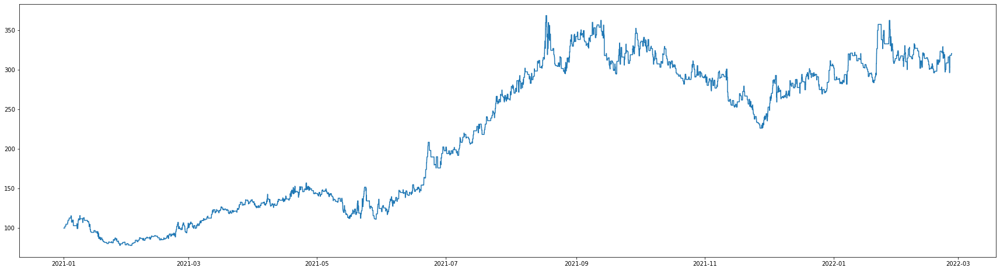

In [18]:
if reinvest_profit_flag == True:
    fig, ax = plt.subplots(figsize=(30, 8))
    ax.plot(budget_dict['time'], budget_dict['budget'])
else:
    print("Not reinvest profit")

In [19]:
if reinvest_profit_flag == True:
    print(f"Max drawdown: {round(max_drawdown * 100, 2)}%")

Max drawdown: 15.37%


In [20]:
win_rate = len(transaction_df[transaction_df['profit'] > 0]) / len(transaction_df)
print(f"Win rate: {round(win_rate * 100, 2)}%")

Win rate: 40.81%


In [21]:
for symbol in transaction_df['symbol'].unique():
    symbol_df = transaction_df[transaction_df['symbol'] == symbol]
    win_rate = len(symbol_df[symbol_df['profit'] > 0]) / len(symbol_df)
    print(f"{symbol} win rate: {round(win_rate * 100, 2)}%")

SOL-PERP win rate: 43.83%
ETH-PERP win rate: 37.92%
LUNA-PERP win rate: 40.19%


In [22]:
print(f"Distribution")
print(pd.DataFrame(transaction_df['profit_percent'].describe()))

Distribution
       profit_percent
count     2257.000000
mean         0.136073
std          3.153871
min        -15.067386
25%         -1.601877
50%         -0.351887
75%          2.450129
max          4.866907


In [23]:
for symbol in transaction_df['symbol'].unique():
    temp_return = transaction_df[transaction_df['symbol'] == symbol]['profit_percent']
    
    print(f"Distribution {symbol}:")
    print(pd.DataFrame(temp_return.describe()))
    print("\n")

Distribution SOL-PERP:
       profit_percent
count      826.000000
mean         0.226643
std          3.436250
min        -12.841591
25%         -1.676297
50%         -0.304897
75%          3.261966
max          4.866907


Distribution ETH-PERP:
       profit_percent
count      712.000000
mean         0.095109
std          2.281204
min         -8.588455
25%         -1.268024
50%         -0.331231
75%          1.409684
max          4.866907


Distribution LUNA-PERP:
       profit_percent
count      719.000000
mean         0.072589
std          3.538080
min        -15.067386
25%         -2.085512
50%         -0.455336
75%          3.060995
max          4.866907




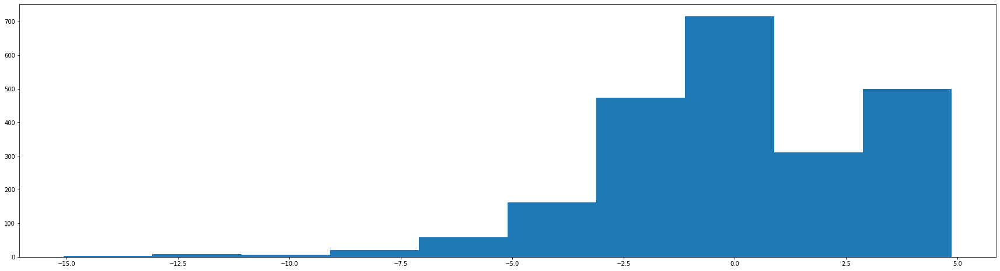

In [24]:
fig, ax = plt.subplots(figsize=(30, 8))
_ = ax.hist(transaction_df['profit_percent'], bins=10)